<a href="https://colab.research.google.com/github/trishnak99/ai-colab-3/blob/master/hw3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

All code after the "Mount dataset" section came from Ugur Uysal's MLS4MIL Image Classification code.

##Mount dataset

In [2]:
from google.colab import drive, files
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
!rm -rf /content/hw3
!mkdir -p /content/hw3/dataset
!mkdir -p /content/hw3/trained_models/trained_weights
!mkdir -p /content/hw3/logs
!cp "/content/drive/My Drive/RuTanks7000_v1_new.zip" /content/hw3
!unzip -q "/content/hw3/RuTanks7000_v1_new.zip" -d /content/hw3/dataset

##Training

Using TensorFlow backend.


Found 42000 images belonging to 6 classes.
Found 90 images belonging to 6 classes.














343613440/343610240 [==============================] - 10s 0us/step

### LEVEL1 ###
pretrained network:
Model: "NASNet"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 331, 331, 3)  0                                            
__________________________________________________________________________________________________
stem_conv1 (Conv2D)             (None, 165, 165, 96) 2592        input_1[0][0]                    
__________________________________________________________________________________________________
stem_bn1 (BatchNormalization)   (None, 165, 165, 96) 384         stem_conv1[0][0]                 
__________________________________________________________________________________________

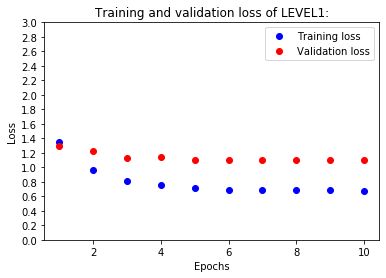

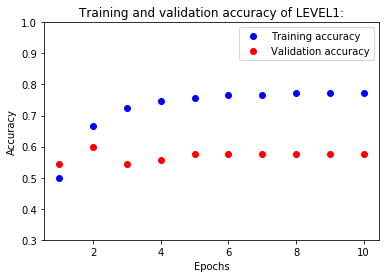


### LEVEL1 Training finished successfully ###

Loading trained weights from /content/hw3/trained_models/trained_weights/weights_temp.h5 ...

### Saving Level1 Model to  /content/hw3/trained_models/RuTanks7000_v1_l1.h5  ... 


### LEVEL2 ###

Loading trained weights from /content/hw3/trained_models/trained_weights/weights_temp.h5 ...

trainable layers before unfreezing the base network up to normal_add_1_15:  510
trainable layers after the base network unfreezed from layer normal_add_1_15:  71

LEVEL2 Model after unfreezing the base network
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
NASNet (Model)               (None, 11, 11, 4032)      84916818  
_________________________________________________________________
global_average_pooling2d_1 ( (None, 4032)              0         
_________________________________________________________________
dense_1 (Dense)              (None,

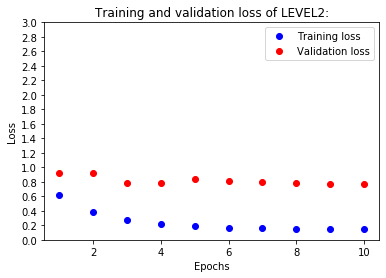

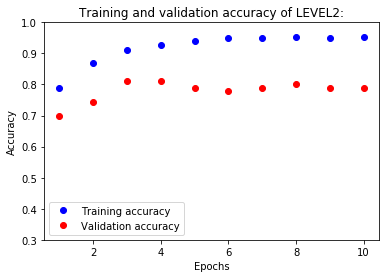


###LEVEL2 Training finished successfully ###
Time elapsed in minutes:  83.19954898846667


In [4]:
import os
from keras.applications import NASNetLarge
from keras import models, layers, optimizers, backend
from keras.models import load_model
from keras.preprocessing.image import ImageDataGenerator
from keras.callbacks import ModelCheckpoint, ReduceLROnPlateau, TensorBoard
import matplotlib.pyplot as plt
import numpy as np
from timeit import default_timer as timer


def main():
    start = timer()
    level1()  # Training the classifier only
    level2()  # Training the pretrained model + the trained classifier from level 1
    end = timer()
    print("Time elapsed in minutes: ", ((end - start)/60))

# Setting Parameters ##################################################################
# image settings
img_height,img_width = 331, 331  # For NASNetLarge

# classes
classnames = ["Background", "BMP2", "Buk-M1-2", "T14", "T90", "ZSU23"]
classes = len(classnames)

# path settings
# path = 'C:\\Users\\uguru\\Documents\\ML4MIL\\'
# dataset_path = path+'datasets\\RuTanks7000_v1\\'
# weights_path = path+'trained_models\\trained_weights\\weights_temp.h5'
# model_path = path+'trained_models\\RuTanks7000_v1_'
# TensorBoardLogDir = path+'logs'
path = '/content/hw3/'
dataset_path = path + 'dataset/RuTanks7000_v1/'
weights_path = path + 'trained_models/trained_weights/weights_temp.h5'
model_path = path + 'trained_models/RuTanks7000_v1_'
TensorBoardLogDir = path + 'logs'

nbrTrainImages = 7000  # per class
nbrTestImages = 0  # Value gets accurate after counting (Total Number of test images)
for ImagesClass in os.listdir(dataset_path+'test/'):
    nbrTestImages += len(os.listdir(dataset_path+'test/'+ImagesClass))

# unfreezing the base network up to a specific layer in Level2:
freezeUptoLayer = "normal_add_1_15"   # NASNetLarge

# hyperparameters
learning_rate = 0.0002  # Learning_rate in Level 2 = learning_rate/10
lr_decay = 0.0001
batch = 64
fcLayer1 = 32
dropout = 0.5

epochsL1 = 10
patiencel1 = 1
factorL1 = 0.5

epochsL2 = 10
patiencel2 = 1
factorL2 = 0.5

verbose_train = 1

# datagenerators https://keras.io/preprocessing/image/
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=30,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    fill_mode='nearest',
    horizontal_flip=True)
train_generator = train_datagen.flow_from_directory(
    dataset_path+'train',
    target_size=(img_height, img_width),
    batch_size=batch,
    shuffle=True,
    classes=classnames,
    class_mode='categorical')

test_datagen = ImageDataGenerator(rescale=1./255)
test_generator = test_datagen.flow_from_directory(
    dataset_path+'test',
    target_size=(img_height, img_width),
    batch_size=1,
    shuffle=True,
    classes=classnames,
    class_mode='categorical')
#########################################################################################

# function to plot results of model performance
def plot(h,t,e):
    history_dict = h[0]
    loss_values = history_dict['loss']
    validation_loss_values = history_dict['val_loss']
    acc_values = history_dict['acc']
    validation_acc_values = history_dict['val_acc']
    epochs_range = range(1, e + 1)

    # Plotting Training and Validation loss of the corresponding Model
    plt.plot(epochs_range, loss_values, 'bo', label='Training loss')
    plt.plot(epochs_range, validation_loss_values, 'ro', label='Validation loss')
    plt.title('Training and validation loss of ' + t)
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.yticks(np.arange(0, 3.1, step=0.2))
    plt.legend()
    plt.show()

    # Plotting Training and Validation accuracy of the corresponding Model
    plt.plot(epochs_range, acc_values, 'bo', label='Training accuracy')
    plt.plot(epochs_range, validation_acc_values, 'ro', label='Validation accuracy')
    plt.title('Training and validation accuracy of ' + t)
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.yticks(np.arange(0.3, 1.1, step=0.1))
    plt.legend()
    plt.show()


# LEVEL1 - Training of densely connected layers
def level1():
    # Building the model using the pretrained model
    conv_base1 = NASNetLarge(weights='imagenet', include_top=False, input_shape=(img_height, img_width, 3))
    print("\n### LEVEL1 ###\npretrained network:")
    conv_base1.summary()
    model = models.Sequential()
    model.add(conv_base1)
    model.add(layers.GlobalAveragePooling2D())
    model.add(layers.Dense(fcLayer1, activation='relu'))
    model.add(layers.Dropout(dropout))
    model.add(layers.Dense(classes, activation='softmax'))

    # freezing the base network
    print("trainable layers bevor freezing:", int(len(model.trainable_weights)/2)) # weights = weights + bias = 2 pro layer
    conv_base1.trainable = False
    print("trainable layers after freezing:", int(len(model.trainable_weights)/2))
    print("\npretrained network + densely connected classifier")
    model.summary()

    # training the added layers only
    model.compile(loss='categorical_crossentropy', optimizer=optimizers.RMSprop(lr=learning_rate, decay=lr_decay), metrics=['acc'])

    callbacks_list_L1 = [ModelCheckpoint(filepath=weights_path, save_weights_only=True, monitor='val_acc', verbose=1, save_best_only=True),
                      ReduceLROnPlateau(monitor='val_acc', factor=factorL1, patience=patiencel1, verbose=1),
                      TensorBoard(log_dir=TensorBoardLogDir+'\\level1')]

    print("\n### Level1 Training ... ")
    # training the model
    history = model.fit_generator(
        train_generator,
        steps_per_epoch=(nbrTrainImages * classes) // (batch * 5),
        epochs=epochsL1,
        callbacks=callbacks_list_L1,
        validation_data=test_generator,
        validation_steps=nbrTestImages,
        verbose=verbose_train)

    history_val1 = [history.history]  # saving all results of the final test
    plot(history_val1, "LEVEL1:", epochsL1)
    print("\n### LEVEL1 Training finished successfully ###")

    print("\nLoading trained weights from " + weights_path + " ...")
    model.load_weights(weights_path)
    model.compile(loss='categorical_crossentropy', optimizer=optimizers.RMSprop(lr=learning_rate), metrics=['acc'])
    print("\n### Saving Level1 Model to ", model_path+'l1.h5', " ... ")
    model.save(model_path+'l1.h5')


# LEVEL2 - Training pretrained network and trained densely connected layers
def level2():
    # Destroying the current TF graph - https://keras.io/backend/
    backend.clear_session()
    print("\n### LEVEL2 ###")
    conv_base2 = NASNetLarge(weights='imagenet', include_top=False, input_shape=(img_height, img_width, 3))
    model2 = models.Sequential()
    model2.add(conv_base2)
    model2.add(layers.GlobalAveragePooling2D())
    model2.add(layers.Dense(fcLayer1, activation='relu'))
    model2.add(layers.Dropout(dropout))
    model2.add(layers.Dense(classes, activation='softmax'))

    print("\nLoading trained weights from " + weights_path + " ...")
    model2.load_weights(weights_path)

    # unfreezing the base network up to a specific layer:
    if freezeUptoLayer == "":
        conv_base2.trainable = True
        print ("\ntrainable layers: ",int(len(model2.trainable_weights) / 2))
    else:
        print("\ntrainable layers before unfreezing the base network up to " + freezeUptoLayer + ": ",int(len(model2.trainable_weights) / 2))  # weights = weights + bias = 2 pro layer
        conv_base2.trainable = True
        set_trainable = False
        for layer in conv_base2.layers:
            if layer.name == freezeUptoLayer: set_trainable = True
            if set_trainable: layer.trainable = True
            else: layer.trainable = False
        print("trainable layers after the base network unfreezed from layer " + freezeUptoLayer + ": ", int(len(model2.trainable_weights)/2))

    print("\nLEVEL2 Model after unfreezing the base network")
    model2.summary()
    model2.compile(loss='categorical_crossentropy', optimizer=optimizers.RMSprop(lr=learning_rate/10, decay=lr_decay), metrics=['acc'])
    print ("\n### Validating ... ")

    val_loss, val_acc = model2.evaluate_generator(test_generator, steps=nbrTestImages, verbose=0)
    print('Validation Results before training unfreeze layers and trained densely connected layers:\nValidation loss:',val_loss,",",'Validation accuracy:', val_acc, "\n")

    # Jointly training both the unfreeze layers and the added trained densely connected layers
    callbacks_list_L2 = [ModelCheckpoint(filepath=model_path+'l2.h5', save_weights_only=False, monitor='val_acc', verbose=1, save_best_only=True),
                      ReduceLROnPlateau(monitor='val_acc', factor=factorL2, patience=patiencel2, verbose=1),
                      TensorBoard(log_dir=TensorBoardLogDir+'\\level2')]

    print ("\n### Level2 Training ... ")
    history = model2.fit_generator(
        train_generator,
        steps_per_epoch=(nbrTrainImages * classes) // (batch * 5),
        epochs=epochsL2,
        callbacks=callbacks_list_L2,
        validation_data=test_generator,
        validation_steps=nbrTestImages,
        verbose=verbose_train)

    history_val2 = [history.history]  # saving all results of the final test
    plot(history_val2, "LEVEL2:", epochsL2)
    print("\n###LEVEL2 Training finished successfully ###")


main()

##Analysis

In [6]:
from tensorflow.python.client import device_lib
for x in device_lib.list_local_devices():
   if x.device_type == "GPU":
     print("***** GPU Information *****")
     print("Device Name: " , x.name)
     print("Memory Limit: " , "%.2f" % float(x.memory_limit/(1000*1000*1000)), "GB")
     print("Description: " , x.physical_device_desc)

***** GPU Information *****
Device Name:  /device:GPU:0
Memory Limit:  15.96 GB
Description:  device: 0, name: Tesla P100-PCIE-16GB, pci bus id: 0000:00:04.0, compute capability: 6.0


Found 90 images belonging to 6 classes.
Loading the trained model from /content/hw3/trained_models/RuTanks7000_v1_l2.h5 ...


Trained model /content/hw3/trained_models/RuTanks7000_v1_l2.h5:
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
NASNet (Model)               (None, 11, 11, 4032)      84916818  
_________________________________________________________________
global_average_pooling2d_1 ( (None, 4032)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 32)                129056    
_________________________________________________________________
dropout_1 (Dropout)          (None, 32)                0         
_________________________________________________________________
dense_2 (Dense)              (None, 6)                 198       
Total params: 85,046,072
Trainable params: 30,292,646
Non-trai

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:122: UserWarning: Update your `Model` call to the Keras 2 API: `Model(outputs=[<tf.Tenso..., inputs=Tensor("NA...)`


img_tensors_array.shape= (90, 331, 331, 3)
activations.shape= (90, 32)


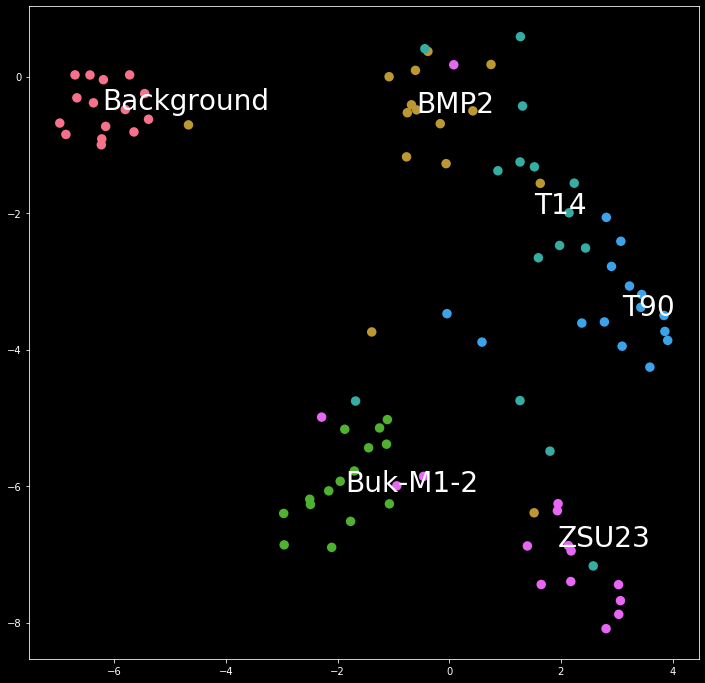


Class Predictions of test images from /content/hw3/dataset/RuTanks7000_v1/test/
Image 1 : [(99.64, 'Background'), (0.15, 'T90'), (0.08, 'BMP2'), (0.07, 'Buk-M1-2'), (0.03, 'T14'), (0.02, 'ZSU23')]


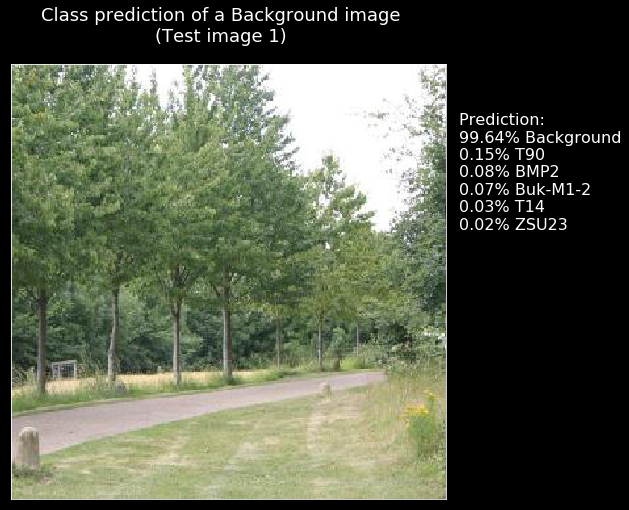

Image 2 : [(98.96, 'Background'), (0.57, 'BMP2'), (0.17, 'T90'), (0.15, 'T14'), (0.08, 'Buk-M1-2'), (0.06, 'ZSU23')]


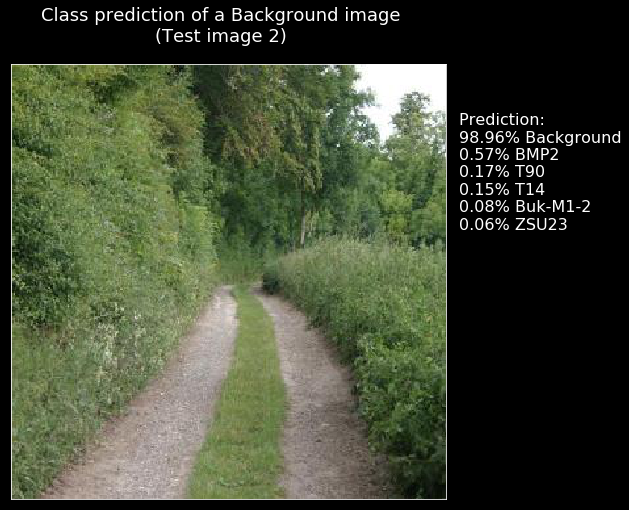

Image 3 : [(99.42, 'Background'), (0.18, 'BMP2'), (0.16, 'T90'), (0.16, 'Buk-M1-2'), (0.05, 'T14'), (0.01, 'ZSU23')]


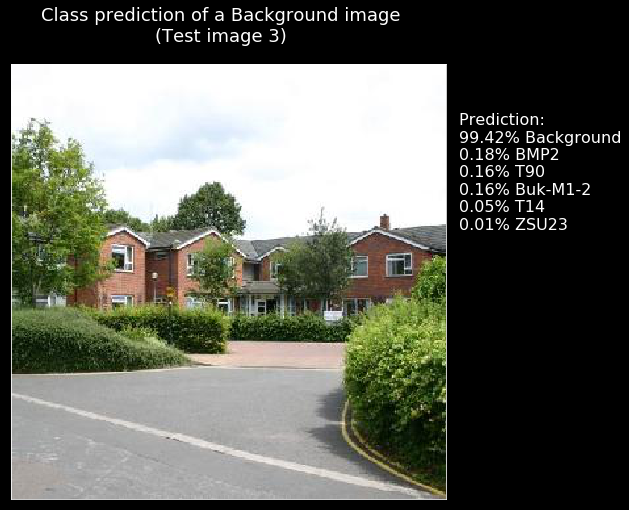

Image 4 : [(99.4, 'Background'), (0.41, 'T90'), (0.08, 'T14'), (0.06, 'BMP2'), (0.03, 'ZSU23'), (0.03, 'Buk-M1-2')]


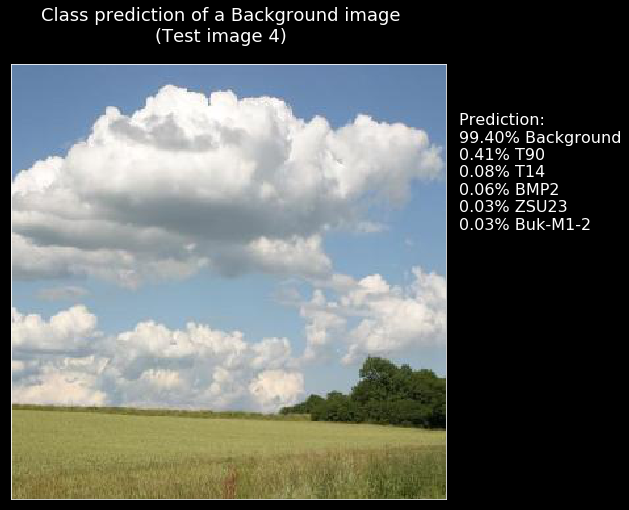

Image 5 : [(97.2, 'Background'), (0.98, 'BMP2'), (0.88, 'Buk-M1-2'), (0.62, 'T90'), (0.19, 'T14'), (0.13, 'ZSU23')]


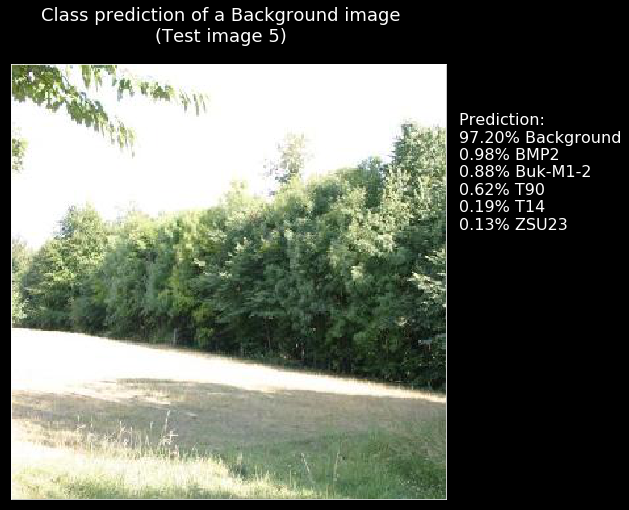

Image 6 : [(99.89, 'Background'), (0.07, 'BMP2'), (0.02, 'T90'), (0.01, 'Buk-M1-2'), (0.0, 'ZSU23'), (0.0, 'T14')]


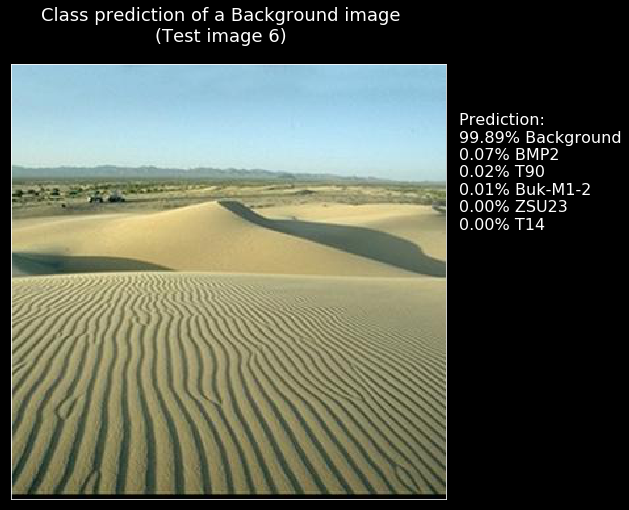

Image 7 : [(99.85, 'Background'), (0.1, 'BMP2'), (0.03, 'T90'), (0.01, 'ZSU23'), (0.01, 'T14'), (0.01, 'Buk-M1-2')]


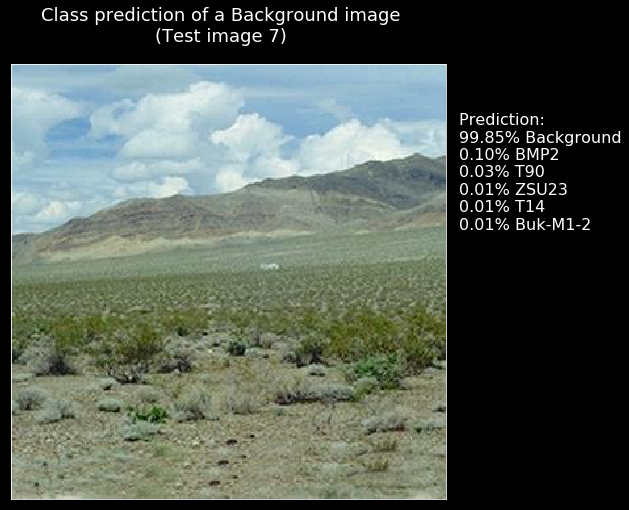

Image 8 : [(98.15, 'Background'), (0.65, 'T90'), (0.64, 'T14'), (0.51, 'BMP2'), (0.05, 'Buk-M1-2'), (0.01, 'ZSU23')]


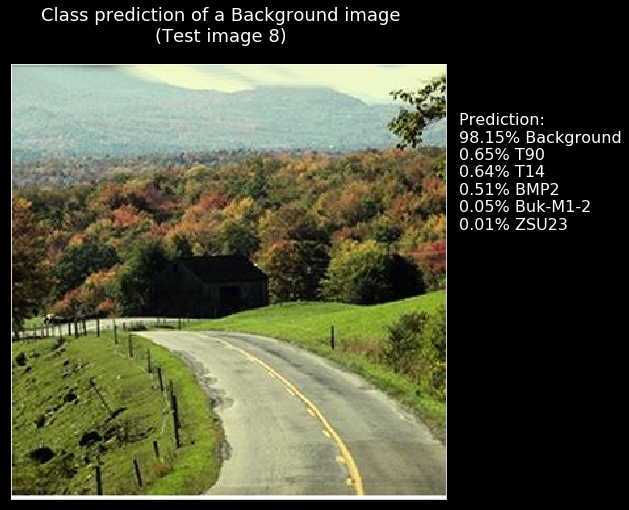

Image 9 : [(99.74, 'Background'), (0.12, 'T90'), (0.05, 'T14'), (0.05, 'BMP2'), (0.04, 'Buk-M1-2'), (0.0, 'ZSU23')]


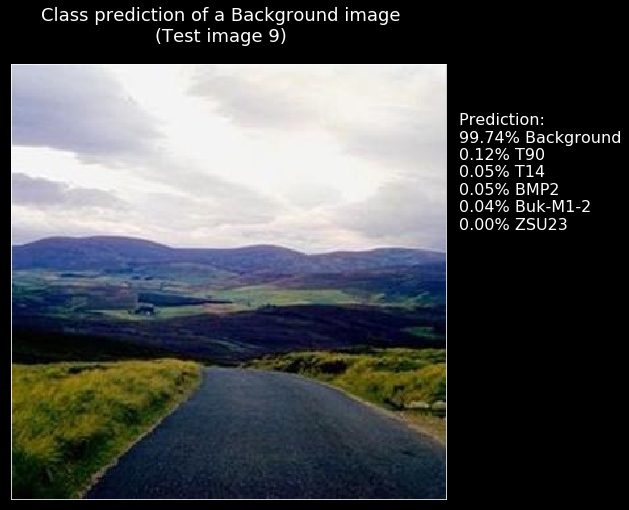

Image 10 : [(97.43, 'Background'), (0.95, 'BMP2'), (0.87, 'T14'), (0.65, 'T90'), (0.09, 'Buk-M1-2'), (0.01, 'ZSU23')]


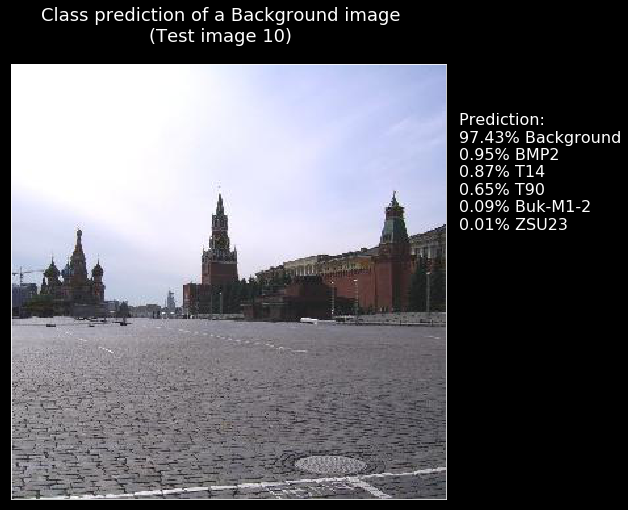

Image 11 : [(99.26, 'Background'), (0.32, 'BMP2'), (0.19, 'T90'), (0.12, 'Buk-M1-2'), (0.09, 'T14'), (0.01, 'ZSU23')]


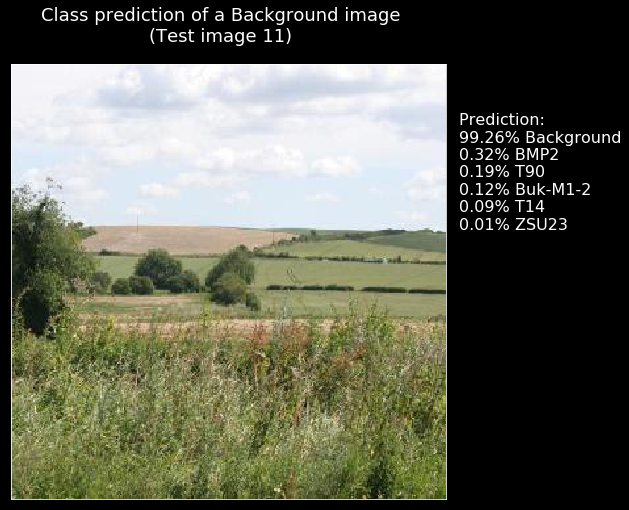

Image 12 : [(98.95, 'Background'), (0.67, 'T90'), (0.16, 'T14'), (0.12, 'BMP2'), (0.07, 'Buk-M1-2'), (0.04, 'ZSU23')]


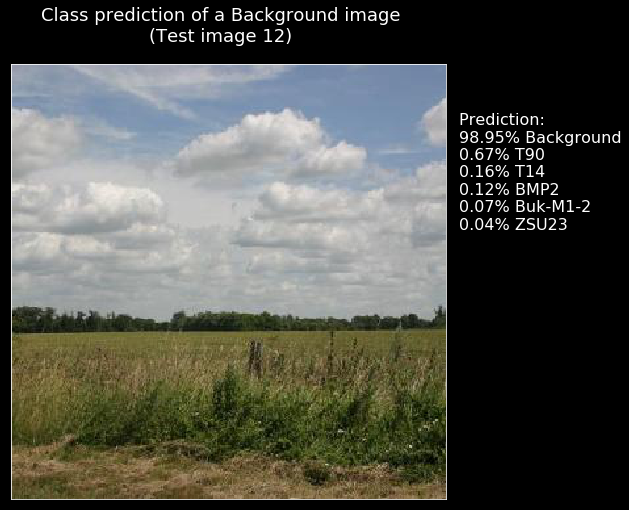

Image 13 : [(99.23, 'Background'), (0.56, 'T90'), (0.08, 'Buk-M1-2'), (0.05, 'ZSU23'), (0.04, 'BMP2'), (0.03, 'T14')]


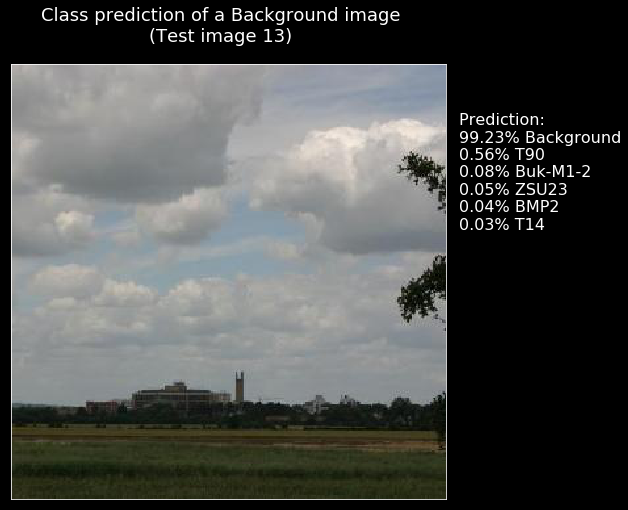

Image 14 : [(99.28, 'Background'), (0.34, 'Buk-M1-2'), (0.19, 'BMP2'), (0.14, 'T90'), (0.04, 'T14'), (0.01, 'ZSU23')]


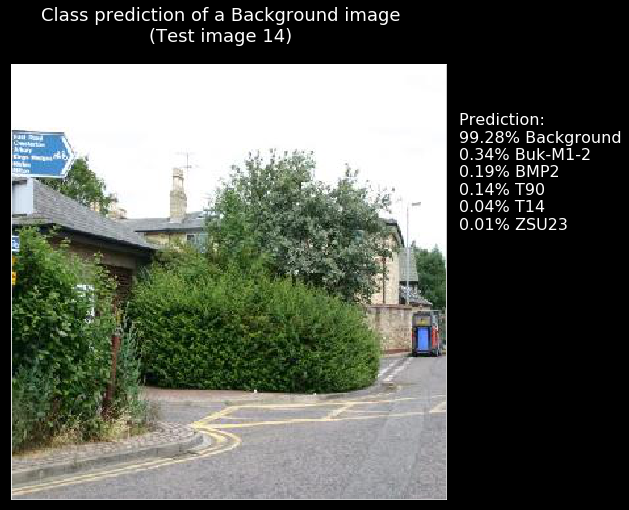

Image 15 : [(95.37, 'Background'), (1.65, 'BMP2'), (1.61, 'T90'), (0.72, 'Buk-M1-2'), (0.58, 'T14'), (0.07, 'ZSU23')]


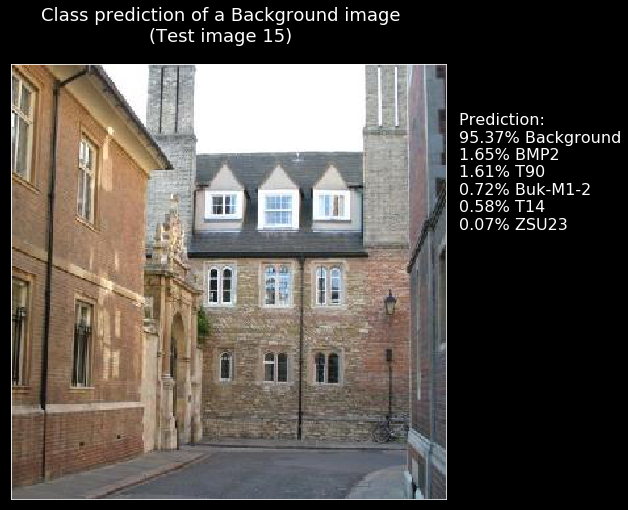

Image 16 : [(63.55, 'BMP2'), (10.95, 'T14'), (8.46, 'Background'), (8.13, 'ZSU23'), (7.65, 'T90'), (1.26, 'Buk-M1-2')]


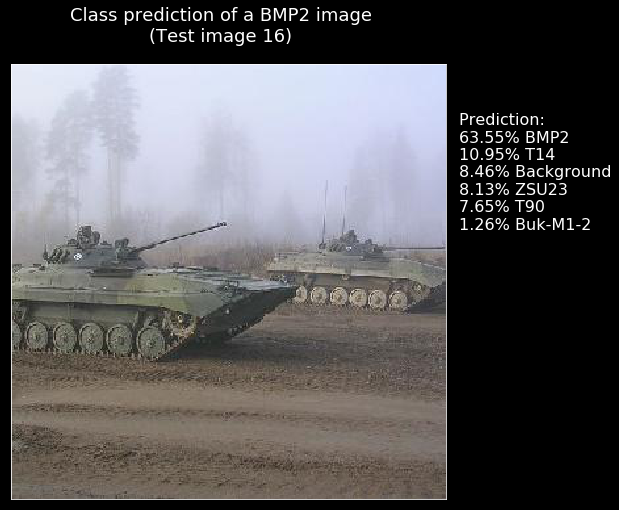

Image 17 : [(95.96, 'BMP2'), (1.74, 'Background'), (0.86, 'T14'), (0.65, 'Buk-M1-2'), (0.53, 'T90'), (0.27, 'ZSU23')]


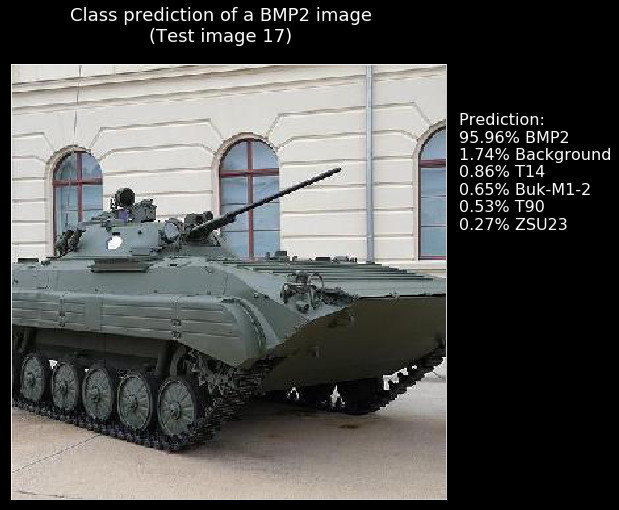

Image 18 : [(34.39, 'ZSU23'), (29.63, 'Buk-M1-2'), (18.53, 'T90'), (15.75, 'Background'), (1.1, 'BMP2'), (0.6, 'T14')]


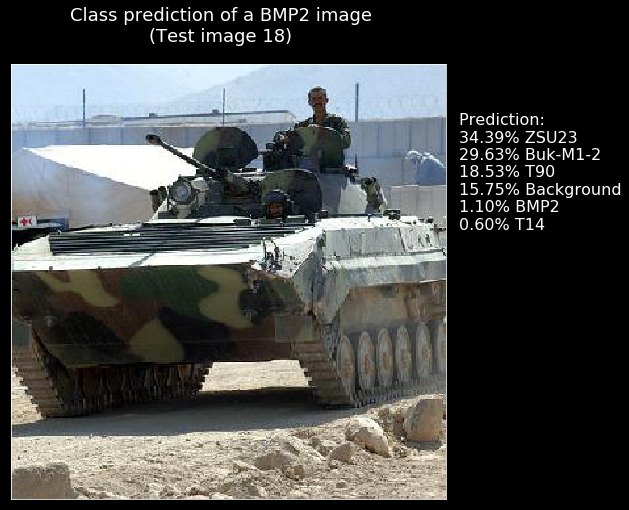

Image 19 : [(40.33, 'BMP2'), (22.53, 'T90'), (13.77, 'Background'), (12.8, 'T14'), (5.5, 'Buk-M1-2'), (5.06, 'ZSU23')]


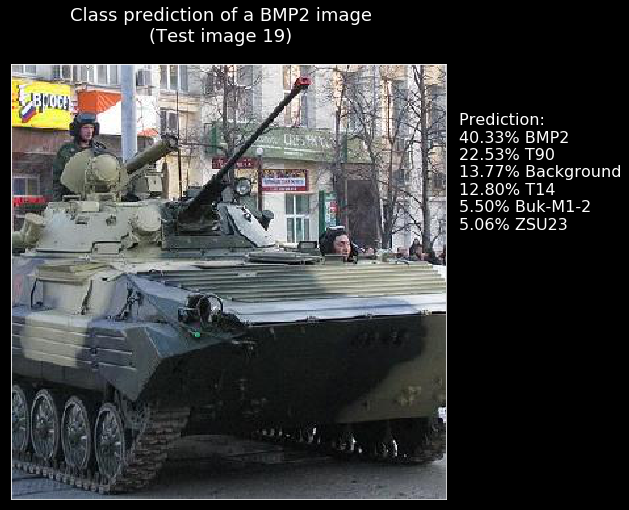

Image 20 : [(82.99, 'BMP2'), (5.95, 'T90'), (4.35, 'Background'), (3.09, 'T14'), (2.13, 'Buk-M1-2'), (1.48, 'ZSU23')]


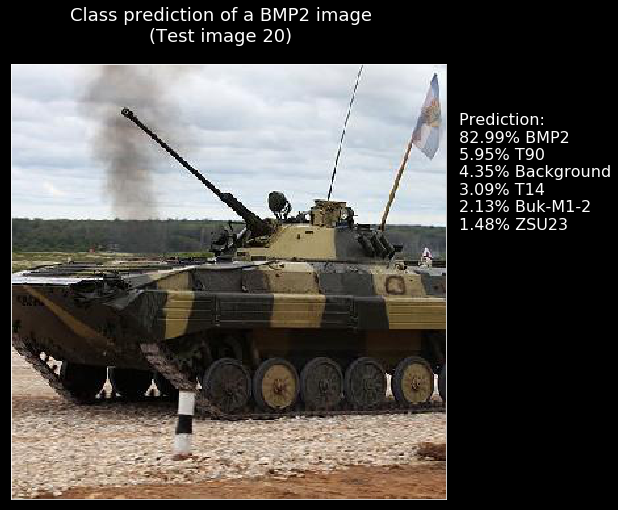

Image 21 : [(53.57, 'Buk-M1-2'), (25.3, 'BMP2'), (18.04, 'Background'), (1.6, 'T14'), (0.94, 'T90'), (0.55, 'ZSU23')]


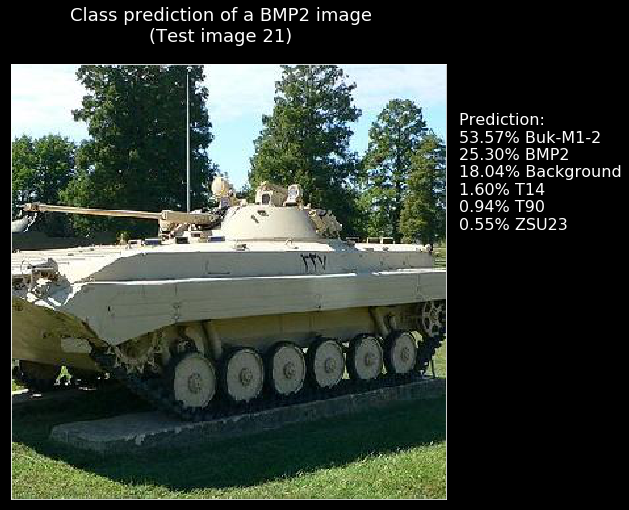

Image 22 : [(87.9, 'BMP2'), (4.0, 'Background'), (3.06, 'Buk-M1-2'), (2.05, 'ZSU23'), (1.71, 'T90'), (1.27, 'T14')]


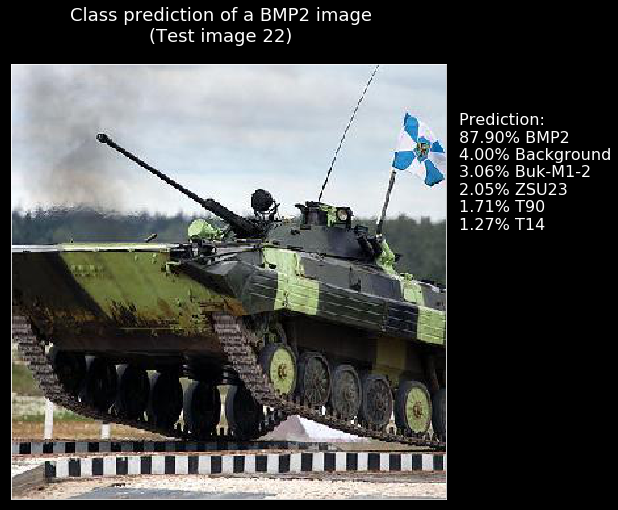

Image 23 : [(94.48, 'BMP2'), (2.43, 'Buk-M1-2'), (1.57, 'T90'), (0.85, 'Background'), (0.35, 'ZSU23'), (0.33, 'T14')]


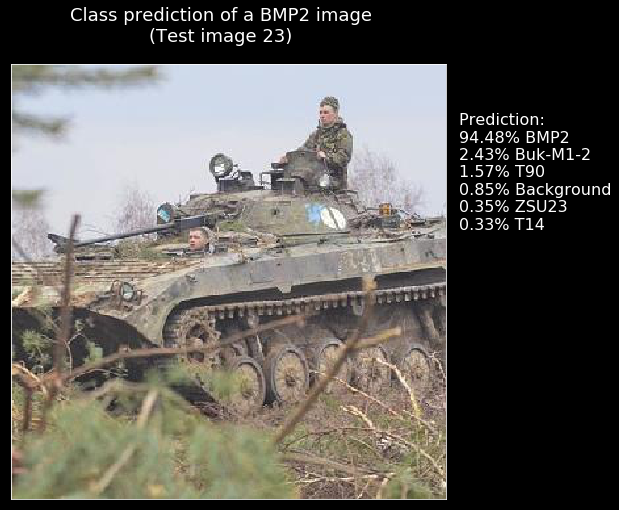

Image 24 : [(69.14, 'BMP2'), (22.43, 'T14'), (3.66, 'T90'), (3.1, 'Background'), (0.98, 'Buk-M1-2'), (0.69, 'ZSU23')]


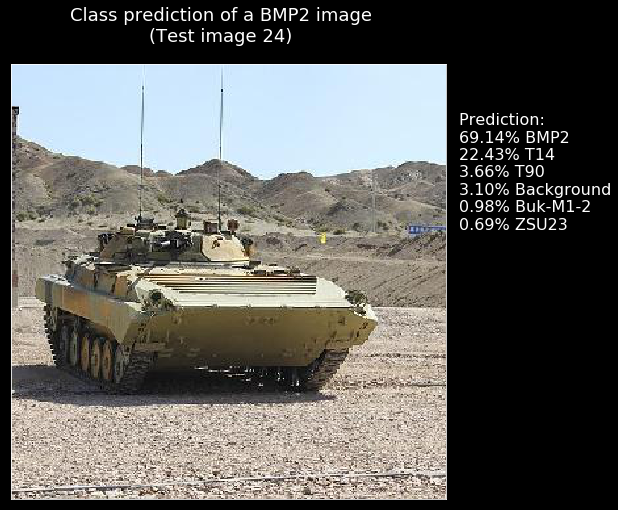

Image 25 : [(97.72, 'BMP2'), (1.02, 'T14'), (0.49, 'Background'), (0.37, 'Buk-M1-2'), (0.21, 'T90'), (0.19, 'ZSU23')]


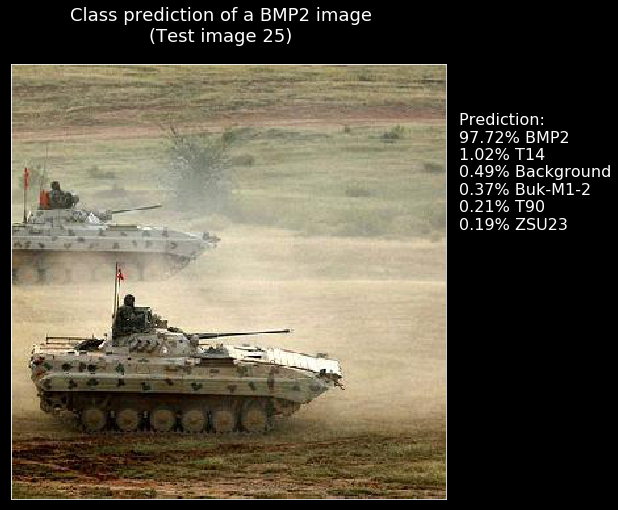

Image 26 : [(46.18, 'BMP2'), (22.59, 'ZSU23'), (20.36, 'T90'), (4.81, 'Buk-M1-2'), (3.7, 'Background'), (2.37, 'T14')]


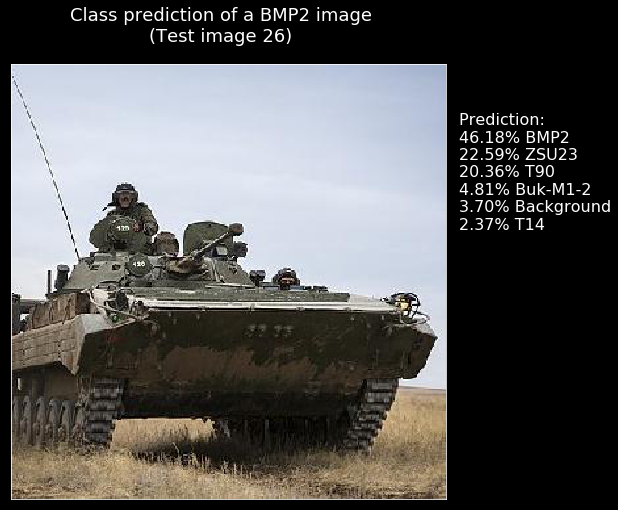

Image 27 : [(72.69, 'T14'), (9.14, 'BMP2'), (8.5, 'Background'), (6.25, 'T90'), (3.26, 'Buk-M1-2'), (0.16, 'ZSU23')]


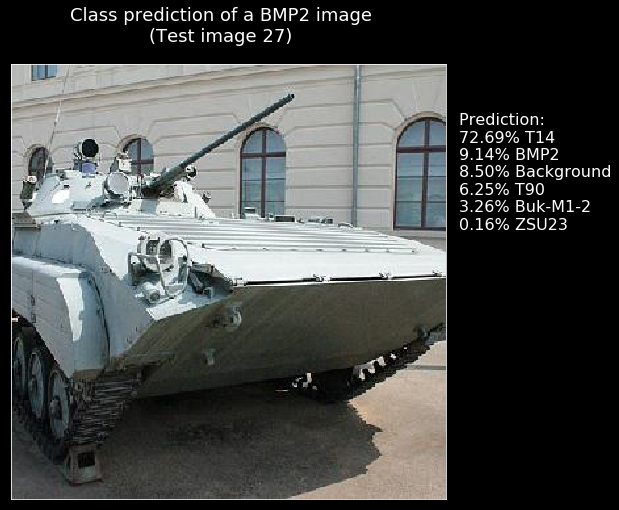

Image 28 : [(82.54, 'BMP2'), (6.71, 'ZSU23'), (5.12, 'T90'), (2.68, 'T14'), (1.68, 'Background'), (1.26, 'Buk-M1-2')]


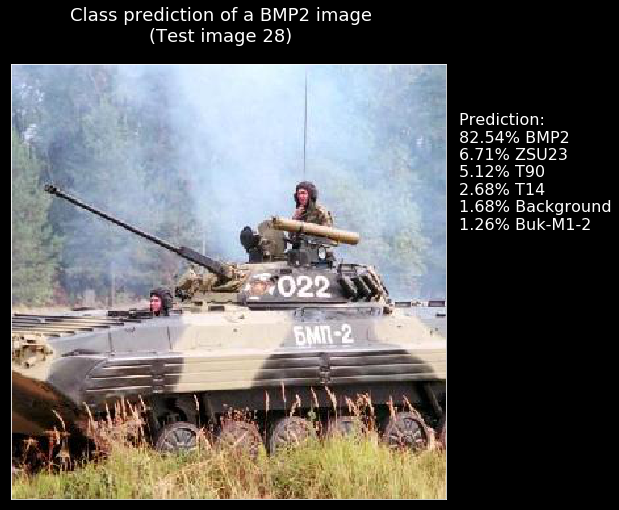

Image 29 : [(83.9, 'Background'), (6.94, 'BMP2'), (4.15, 'T14'), (3.06, 'T90'), (1.38, 'ZSU23'), (0.58, 'Buk-M1-2')]


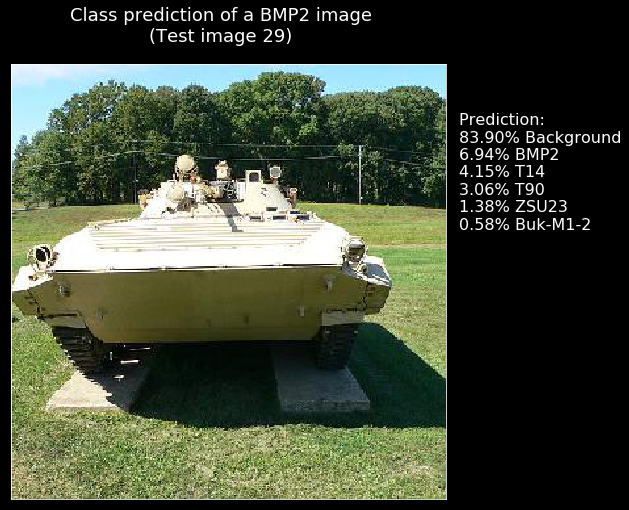

Image 30 : [(78.19, 'BMP2'), (19.23, 'T14'), (1.84, 'Background'), (0.37, 'Buk-M1-2'), (0.24, 'T90'), (0.13, 'ZSU23')]


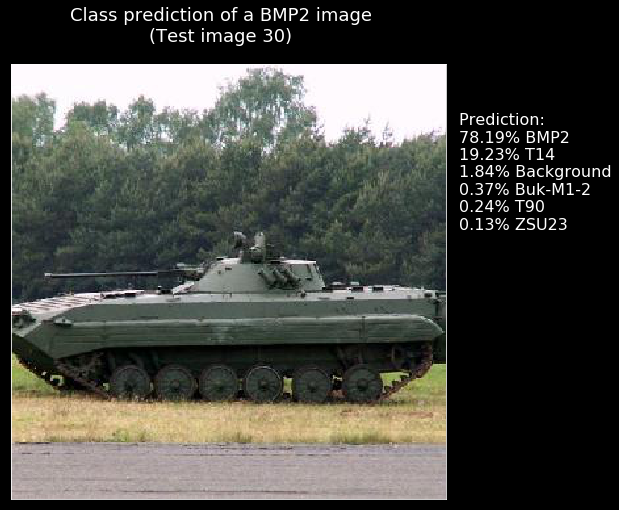

Image 31 : [(99.95, 'Buk-M1-2'), (0.04, 'Background'), (0.01, 'T90'), (0.0, 'ZSU23'), (0.0, 'T14'), (0.0, 'BMP2')]


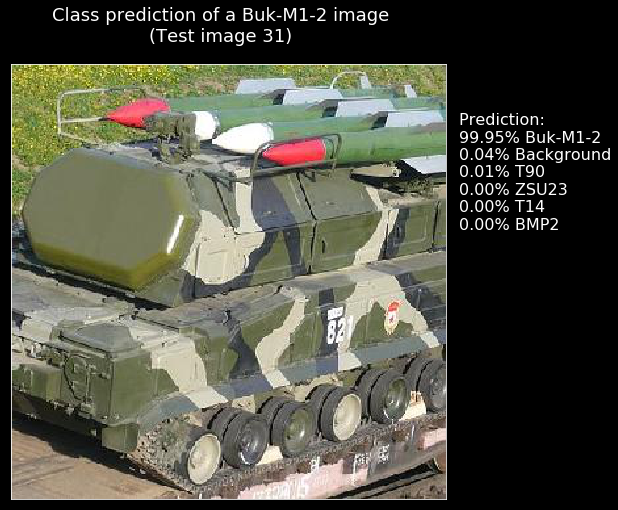

Image 32 : [(99.34, 'Buk-M1-2'), (0.33, 'Background'), (0.24, 'T90'), (0.06, 'BMP2'), (0.01, 'ZSU23'), (0.01, 'T14')]


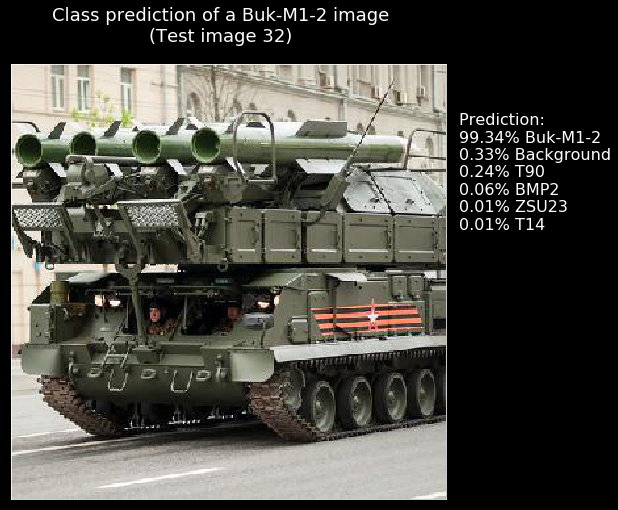

Image 33 : [(99.63, 'Buk-M1-2'), (0.21, 'Background'), (0.12, 'T90'), (0.03, 'BMP2'), (0.0, 'ZSU23'), (0.0, 'T14')]


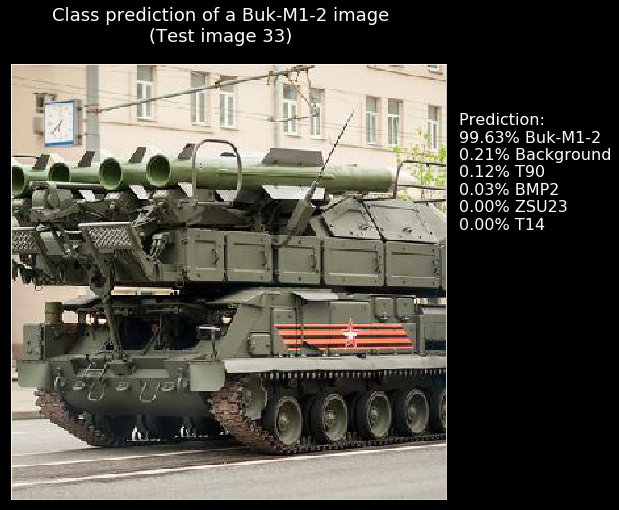

Image 34 : [(98.56, 'Buk-M1-2'), (1.08, 'Background'), (0.24, 'T90'), (0.06, 'BMP2'), (0.05, 'ZSU23'), (0.01, 'T14')]


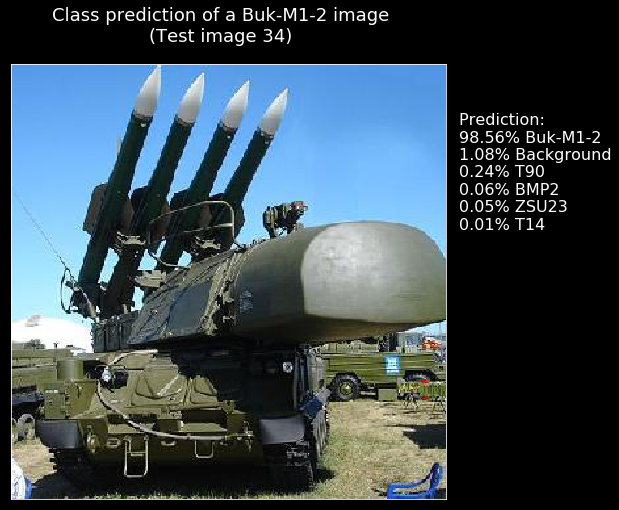

Image 35 : [(86.02, 'Buk-M1-2'), (10.82, 'Background'), (1.8, 'T90'), (0.91, 'BMP2'), (0.34, 'T14'), (0.11, 'ZSU23')]


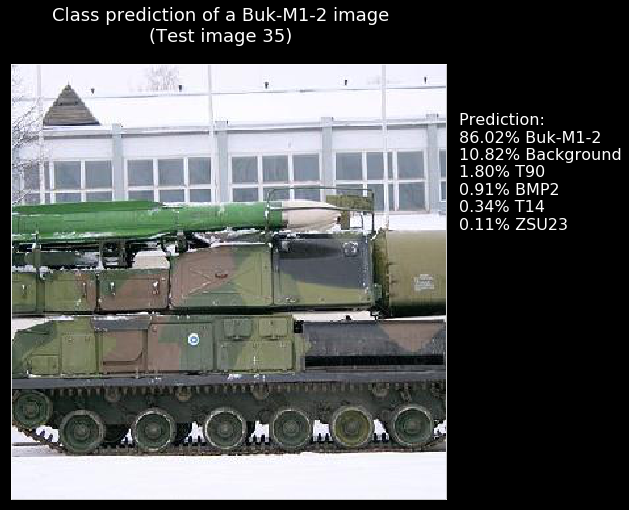

Image 36 : [(96.07, 'Buk-M1-2'), (2.39, 'T90'), (1.24, 'Background'), (0.15, 'ZSU23'), (0.09, 'BMP2'), (0.06, 'T14')]


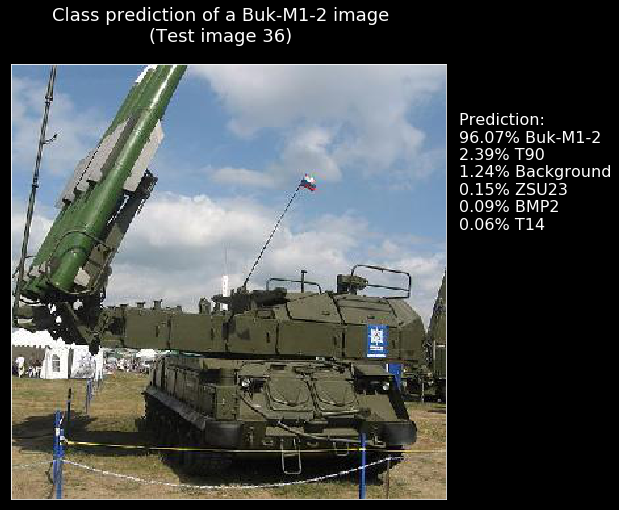

Image 37 : [(89.67, 'Buk-M1-2'), (3.68, 'Background'), (3.53, 'T90'), (2.42, 'BMP2'), (0.35, 'ZSU23'), (0.34, 'T14')]


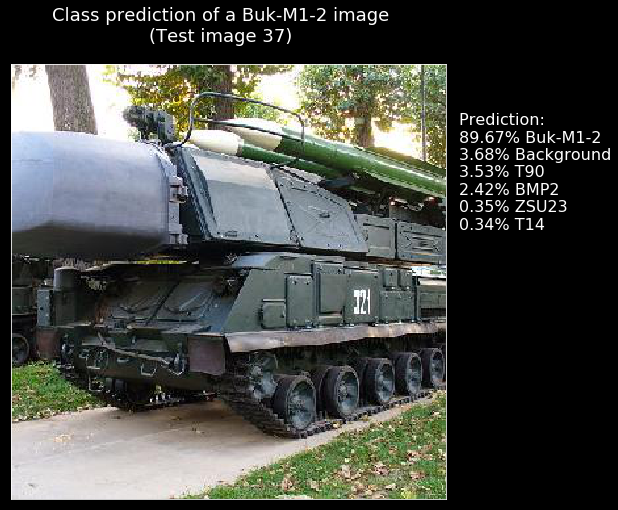

Image 38 : [(99.23, 'Buk-M1-2'), (0.64, 'Background'), (0.09, 'T90'), (0.02, 'ZSU23'), (0.02, 'BMP2'), (0.0, 'T14')]


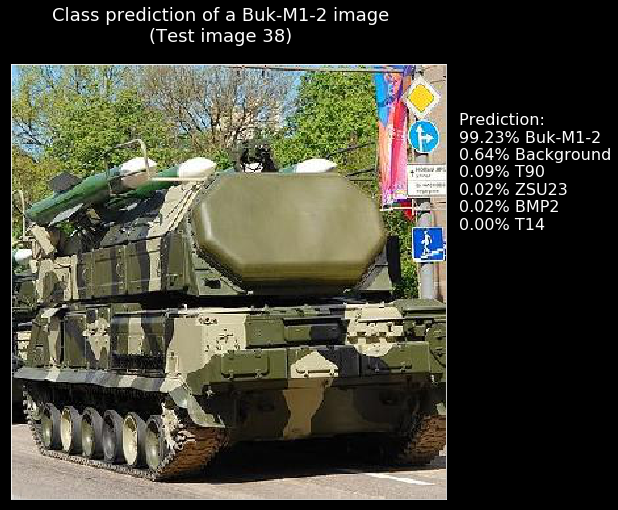

Image 39 : [(95.4, 'Buk-M1-2'), (2.92, 'T90'), (1.0, 'Background'), (0.49, 'BMP2'), (0.14, 'ZSU23'), (0.06, 'T14')]


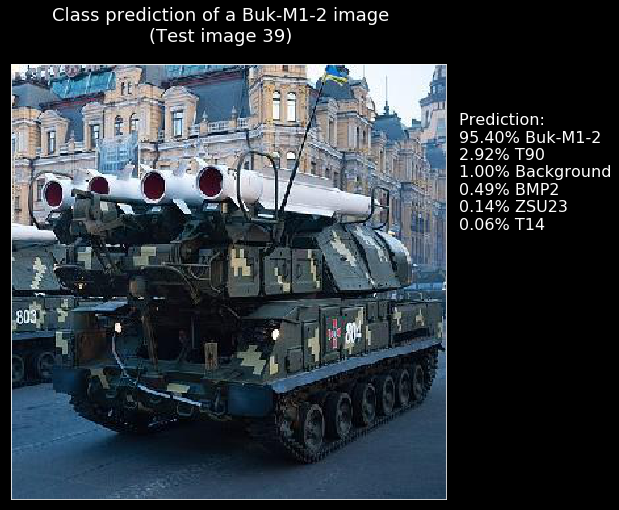

Image 40 : [(99.44, 'Buk-M1-2'), (0.32, 'Background'), (0.21, 'T90'), (0.02, 'BMP2'), (0.01, 'T14'), (0.0, 'ZSU23')]


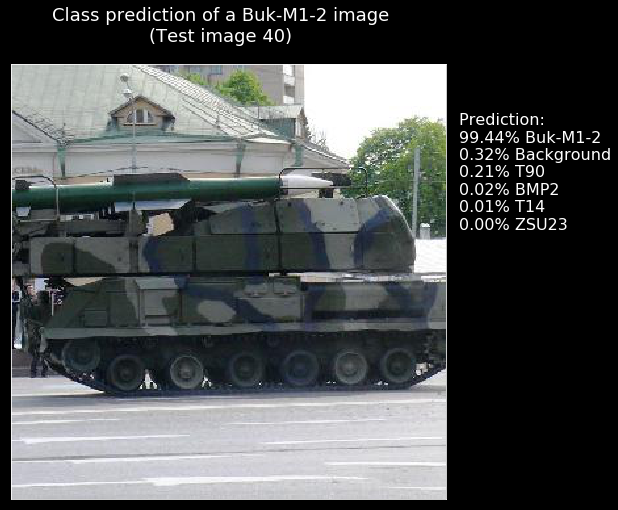

Image 41 : [(97.92, 'Buk-M1-2'), (0.93, 'Background'), (0.72, 'T90'), (0.25, 'BMP2'), (0.14, 'ZSU23'), (0.04, 'T14')]


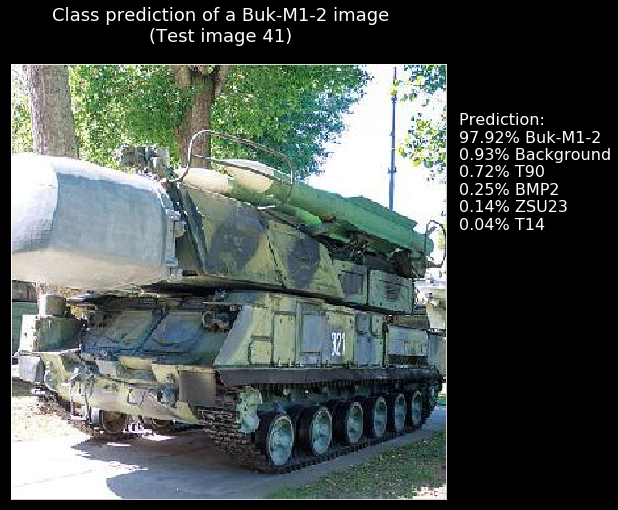

Image 42 : [(99.88, 'Buk-M1-2'), (0.06, 'Background'), (0.03, 'T90'), (0.02, 'BMP2'), (0.0, 'ZSU23'), (0.0, 'T14')]


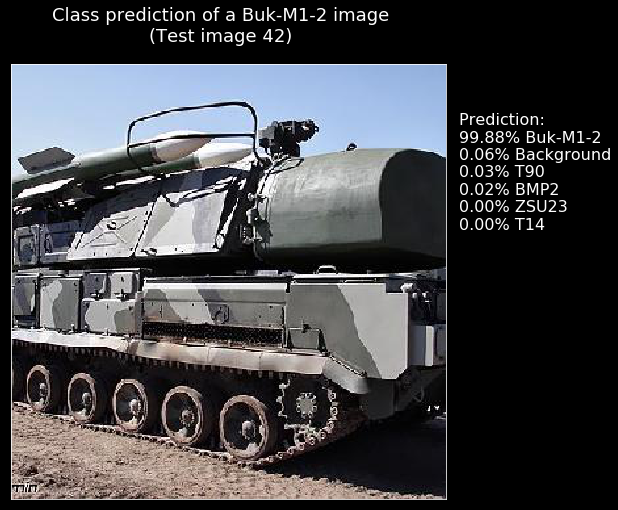

Image 43 : [(96.6, 'Buk-M1-2'), (1.2, 'BMP2'), (1.03, 'T90'), (1.03, 'Background'), (0.08, 'T14'), (0.06, 'ZSU23')]


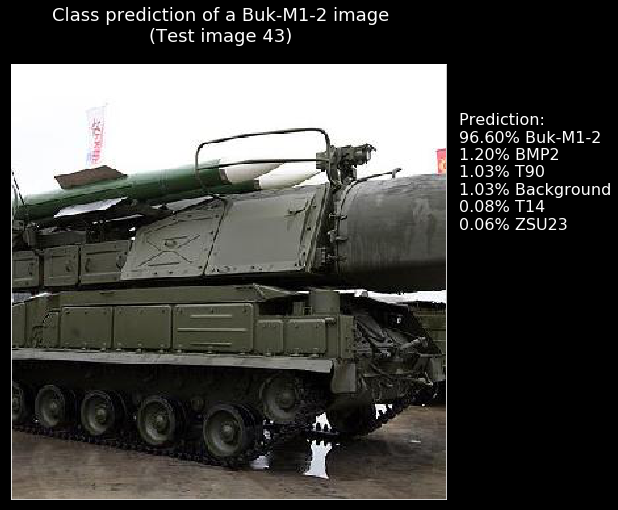

Image 44 : [(91.29, 'Buk-M1-2'), (4.13, 'Background'), (3.03, 'T90'), (1.33, 'BMP2'), (0.13, 'ZSU23'), (0.08, 'T14')]


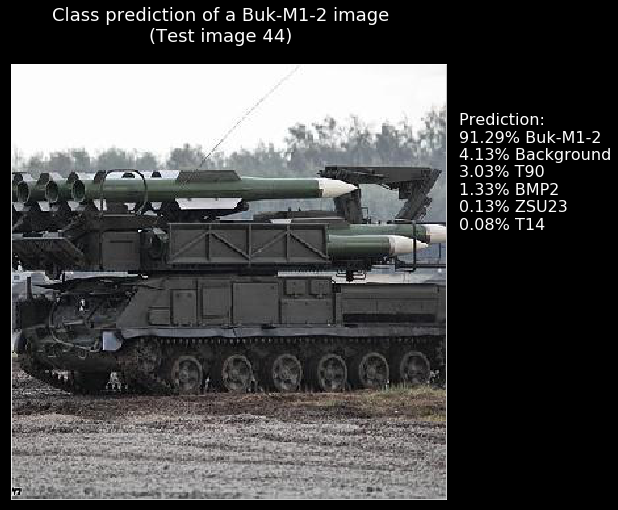

Image 45 : [(98.16, 'Buk-M1-2'), (1.26, 'Background'), (0.38, 'T90'), (0.13, 'BMP2'), (0.05, 'T14'), (0.02, 'ZSU23')]


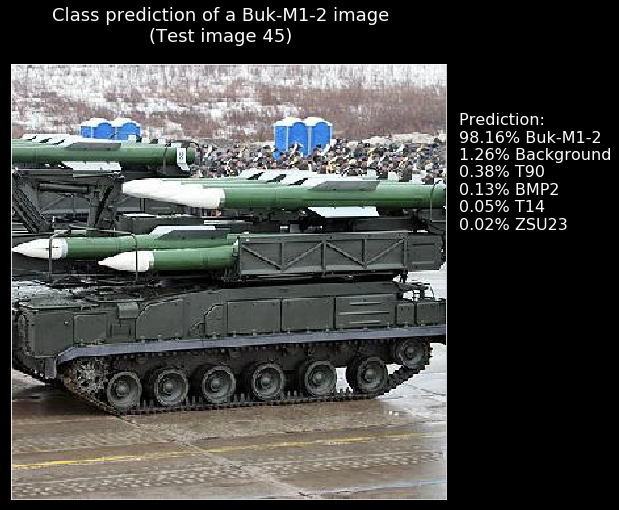

Image 46 : [(96.33, 'BMP2'), (1.62, 'T14'), (1.05, 'Background'), (0.55, 'Buk-M1-2'), (0.39, 'T90'), (0.05, 'ZSU23')]


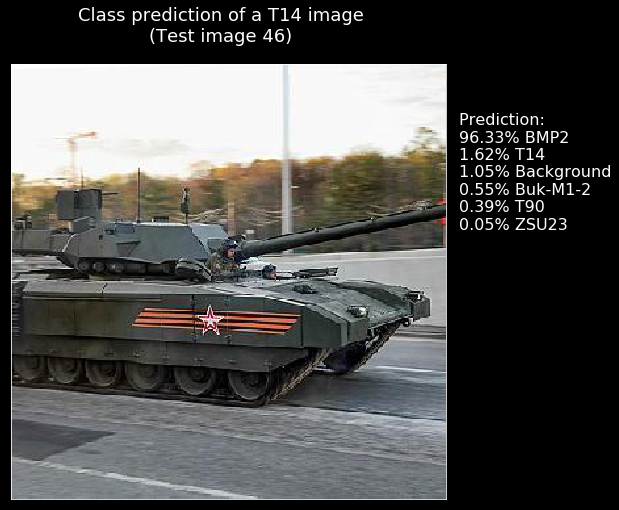

Image 47 : [(38.39, 'T14'), (28.84, 'BMP2'), (15.35, 'Background'), (9.97, 'T90'), (5.98, 'Buk-M1-2'), (1.47, 'ZSU23')]


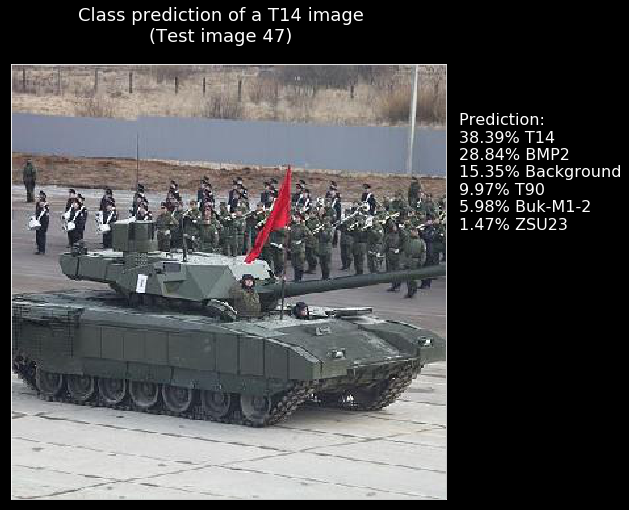

Image 48 : [(90.64, 'Buk-M1-2'), (3.69, 'BMP2'), (3.07, 'Background'), (1.8, 'T90'), (0.71, 'T14'), (0.08, 'ZSU23')]


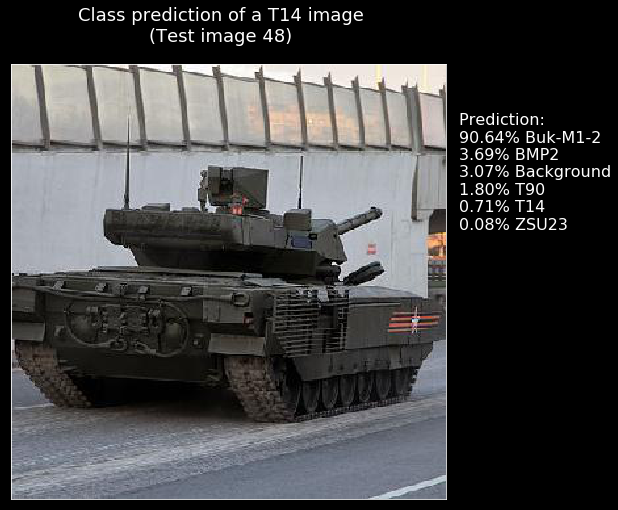

Image 49 : [(68.84, 'T14'), (14.65, 'BMP2'), (7.14, 'Background'), (5.75, 'T90'), (3.45, 'Buk-M1-2'), (0.17, 'ZSU23')]


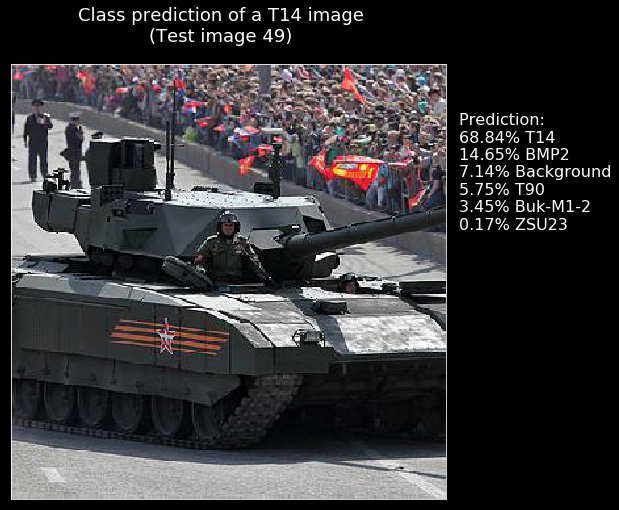

Image 50 : [(43.76, 'Buk-M1-2'), (28.18, 'Background'), (9.73, 'T14'), (7.92, 'T90'), (5.29, 'ZSU23'), (5.11, 'BMP2')]


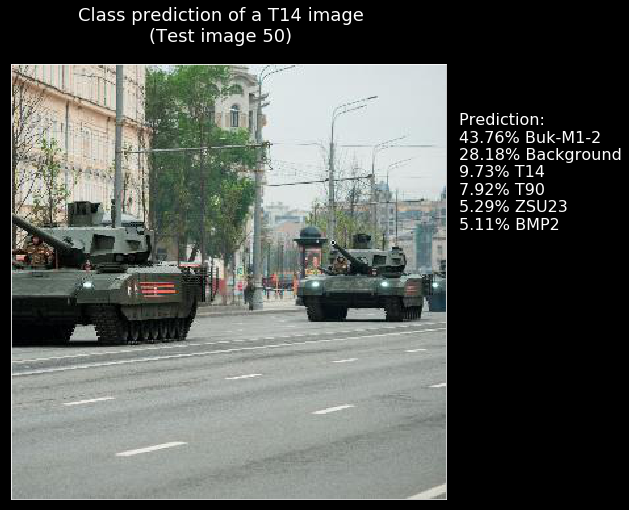

Image 51 : [(58.99, 'T14'), (36.03, 'BMP2'), (3.43, 'Background'), (1.0, 'T90'), (0.49, 'Buk-M1-2'), (0.06, 'ZSU23')]


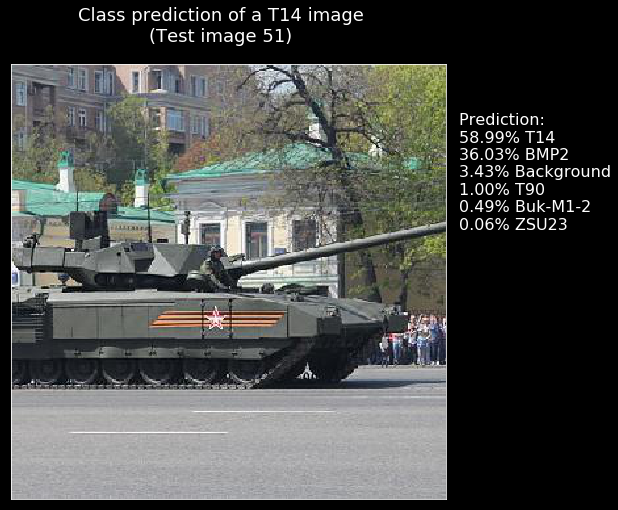

Image 52 : [(72.03, 'T14'), (17.27, 'T90'), (4.76, 'Background'), (3.66, 'BMP2'), (2.16, 'Buk-M1-2'), (0.13, 'ZSU23')]


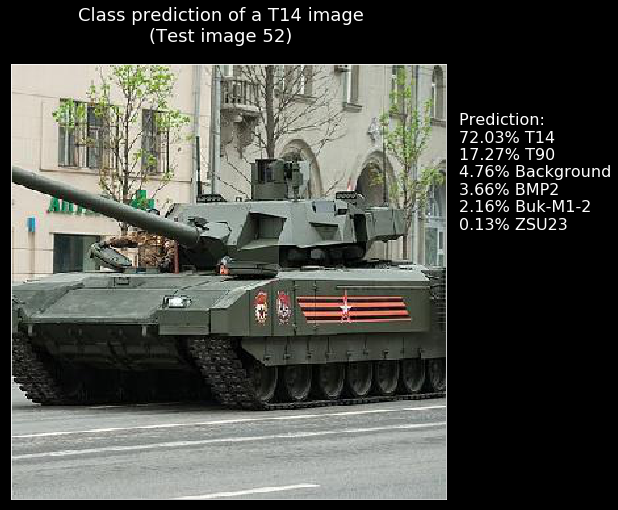

Image 53 : [(43.1, 'T14'), (32.28, 'BMP2'), (13.85, 'Buk-M1-2'), (6.36, 'Background'), (4.21, 'T90'), (0.2, 'ZSU23')]


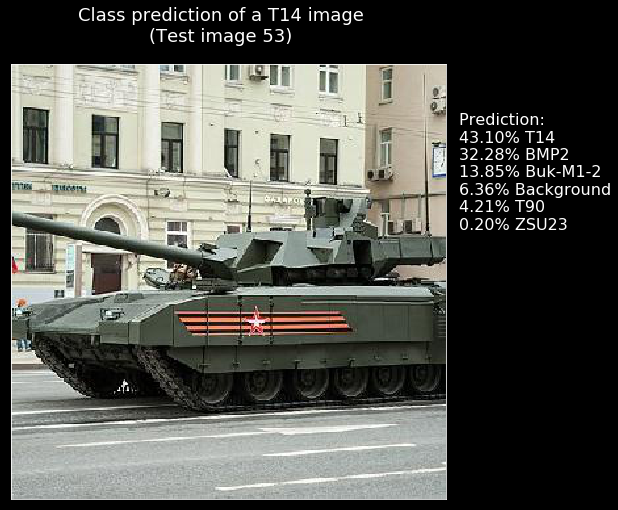

Image 54 : [(60.05, 'BMP2'), (39.55, 'T14'), (0.19, 'Background'), (0.13, 'Buk-M1-2'), (0.06, 'T90'), (0.02, 'ZSU23')]


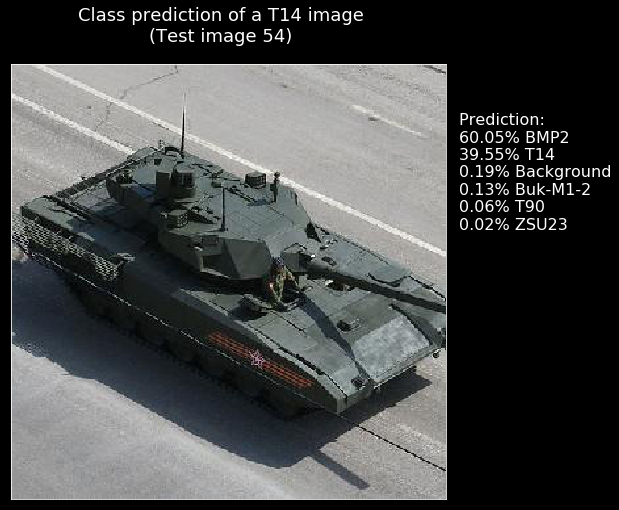

Image 55 : [(90.99, 'ZSU23'), (6.5, 'T90'), (1.38, 'Background'), (1.02, 'Buk-M1-2'), (0.09, 'T14'), (0.03, 'BMP2')]


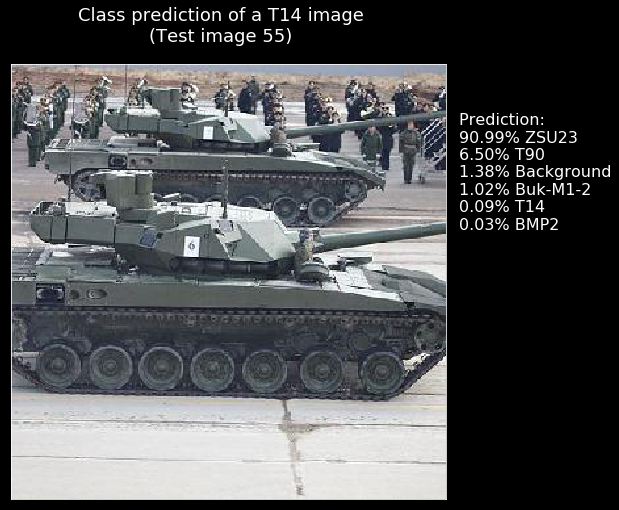

Image 56 : [(41.29, 'ZSU23'), (27.06, 'T90'), (11.17, 'Buk-M1-2'), (8.16, 'T14'), (7.52, 'Background'), (4.79, 'BMP2')]


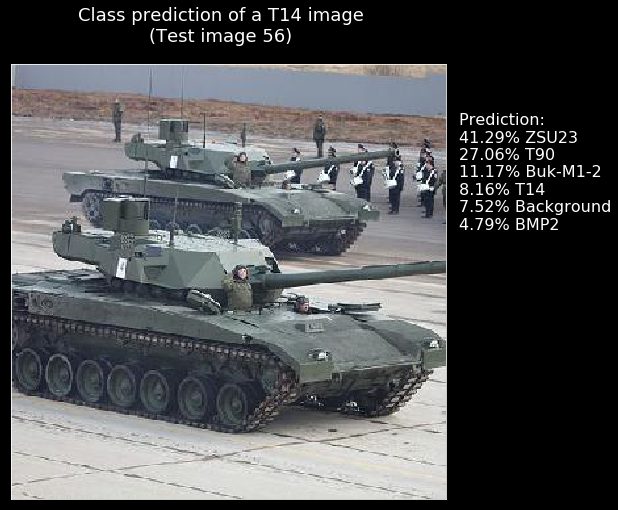

Image 57 : [(46.22, 'T14'), (23.03, 'Buk-M1-2'), (21.86, 'T90'), (6.06, 'Background'), (2.63, 'BMP2'), (0.2, 'ZSU23')]


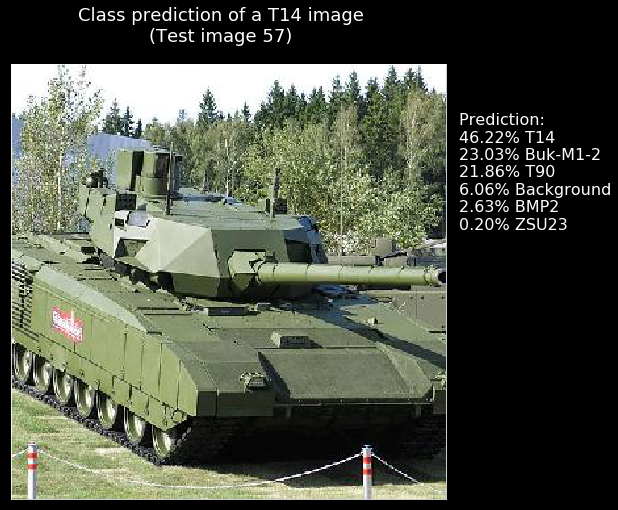

Image 58 : [(65.78, 'T14'), (22.12, 'T90'), (8.94, 'Background'), (1.51, 'BMP2'), (1.16, 'Buk-M1-2'), (0.49, 'ZSU23')]


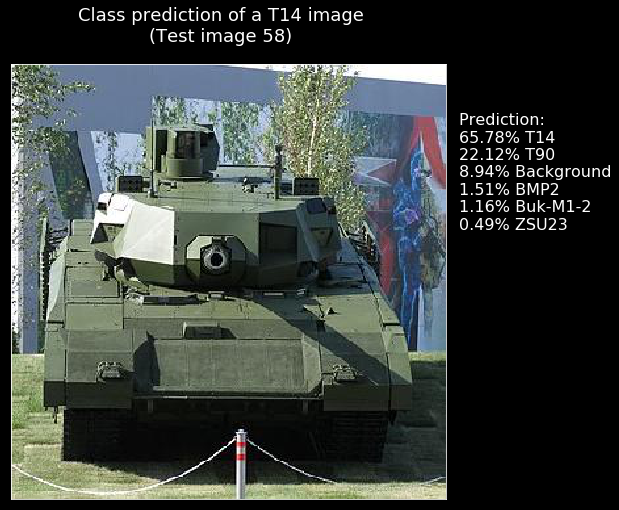

Image 59 : [(70.0, 'T14'), (18.79, 'T90'), (6.31, 'Buk-M1-2'), (3.1, 'BMP2'), (1.07, 'Background'), (0.74, 'ZSU23')]


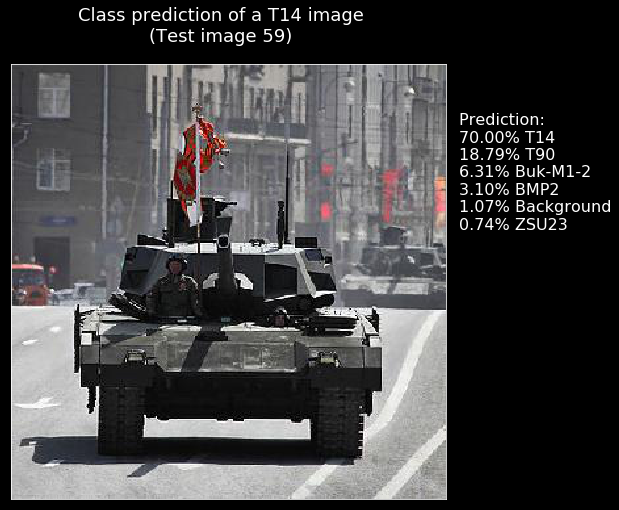

Image 60 : [(84.12, 'T14'), (8.58, 'T90'), (3.93, 'BMP2'), (2.8, 'Background'), (0.53, 'Buk-M1-2'), (0.05, 'ZSU23')]


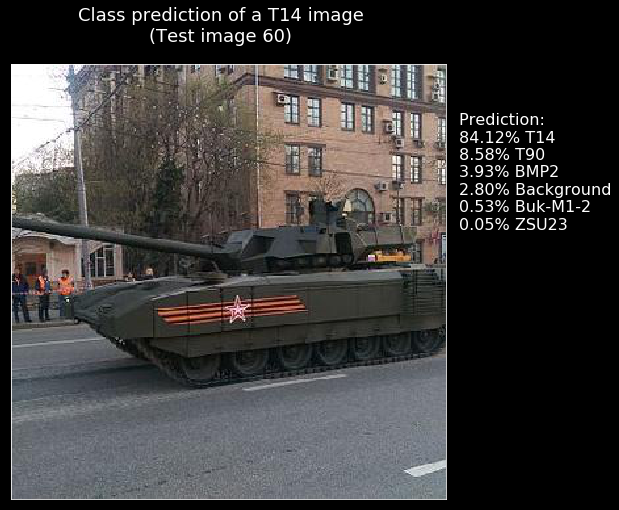

Image 61 : [(83.58, 'T90'), (11.24, 'T14'), (2.01, 'Buk-M1-2'), (1.89, 'Background'), (0.67, 'BMP2'), (0.61, 'ZSU23')]


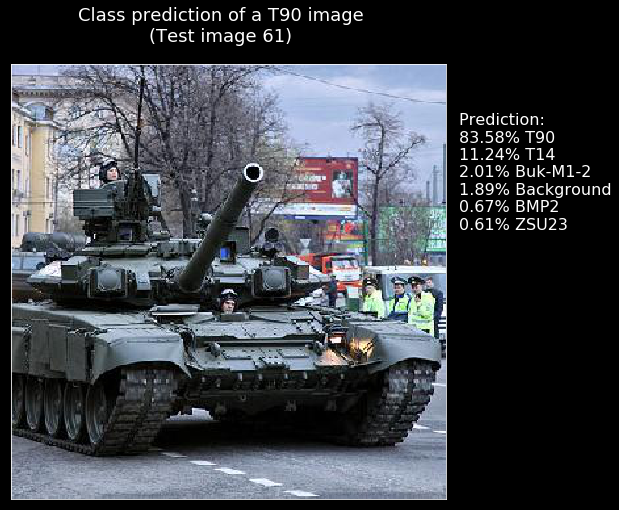

Image 62 : [(88.54, 'T90'), (4.79, 'ZSU23'), (3.18, 'T14'), (1.84, 'Background'), (1.17, 'Buk-M1-2'), (0.48, 'BMP2')]


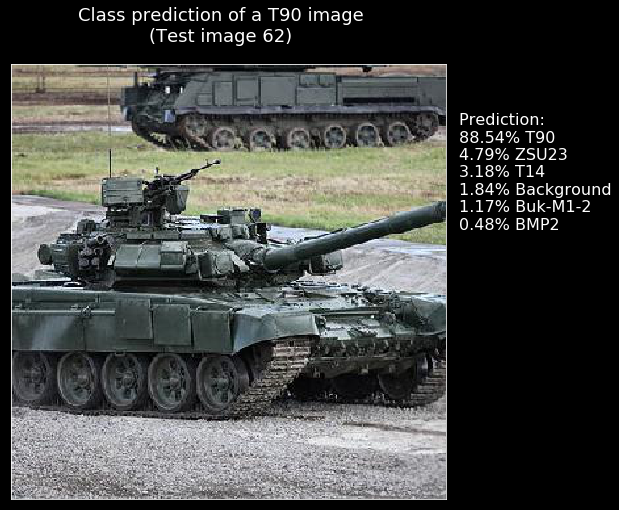

Image 63 : [(64.43, 'T90'), (22.79, 'T14'), (5.23, 'BMP2'), (4.06, 'Background'), (2.68, 'Buk-M1-2'), (0.82, 'ZSU23')]


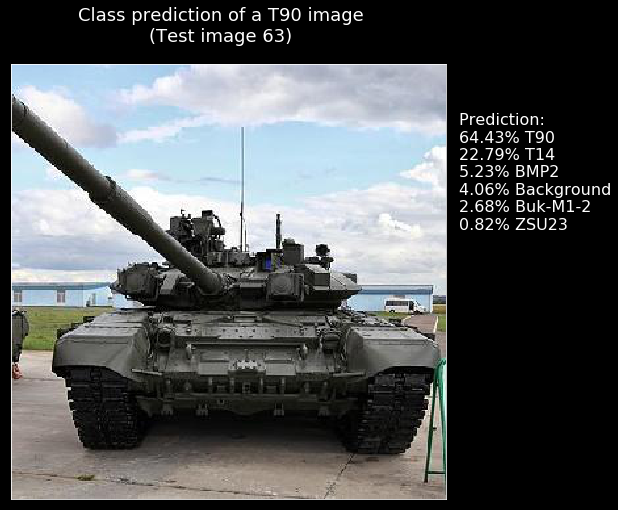

Image 64 : [(94.49, 'T90'), (2.88, 'T14'), (1.04, 'Background'), (0.76, 'ZSU23'), (0.67, 'Buk-M1-2'), (0.15, 'BMP2')]


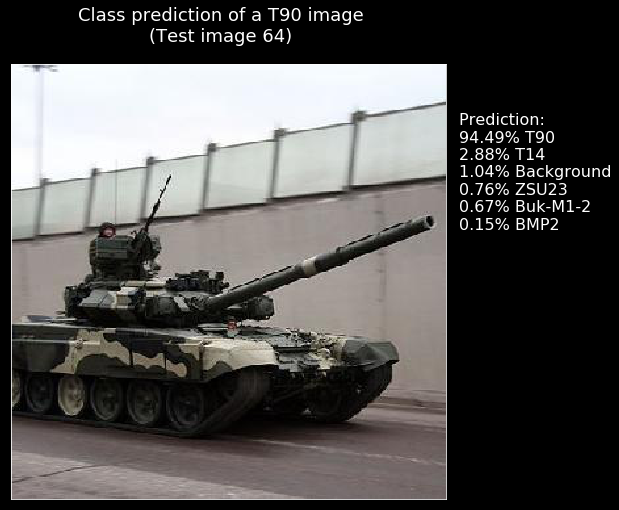

Image 65 : [(86.71, 'T90'), (6.84, 'ZSU23'), (2.54, 'Buk-M1-2'), (1.91, 'T14'), (1.88, 'Background'), (0.12, 'BMP2')]


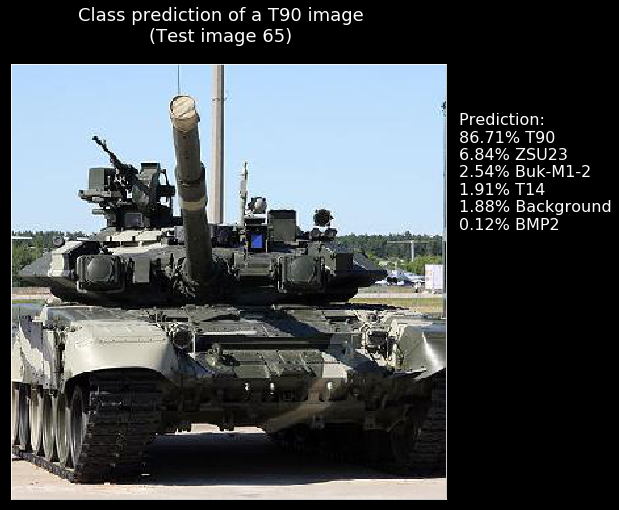

Image 66 : [(82.17, 'T90'), (13.54, 'T14'), (1.34, 'ZSU23'), (1.33, 'Background'), (1.16, 'Buk-M1-2'), (0.45, 'BMP2')]


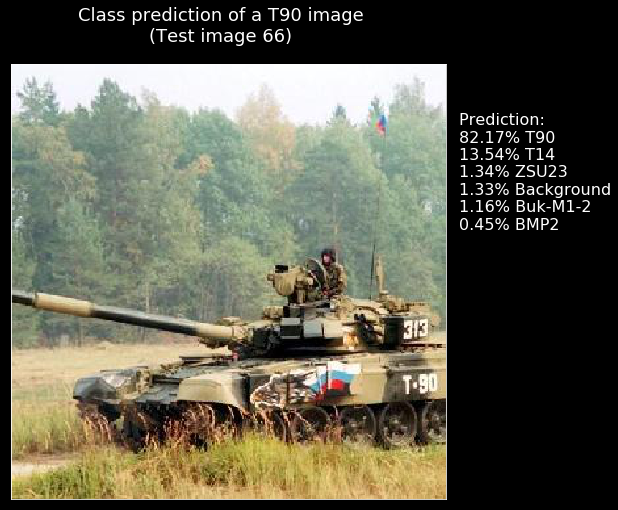

Image 67 : [(81.15, 'T90'), (9.48, 'T14'), (5.51, 'Buk-M1-2'), (2.6, 'Background'), (0.88, 'ZSU23'), (0.38, 'BMP2')]


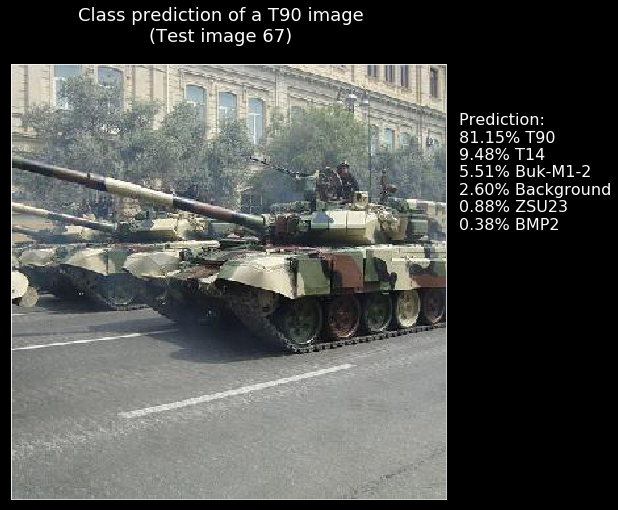

Image 68 : [(92.6, 'T90'), (2.84, 'ZSU23'), (2.82, 'T14'), (1.03, 'Background'), (0.61, 'Buk-M1-2'), (0.1, 'BMP2')]


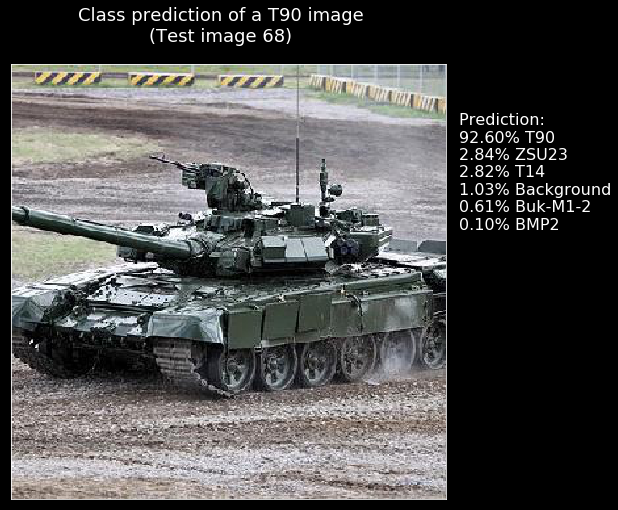

Image 69 : [(46.79, 'T90'), (40.8, 'T14'), (4.65, 'Background'), (3.78, 'ZSU23'), (3.66, 'Buk-M1-2'), (0.32, 'BMP2')]


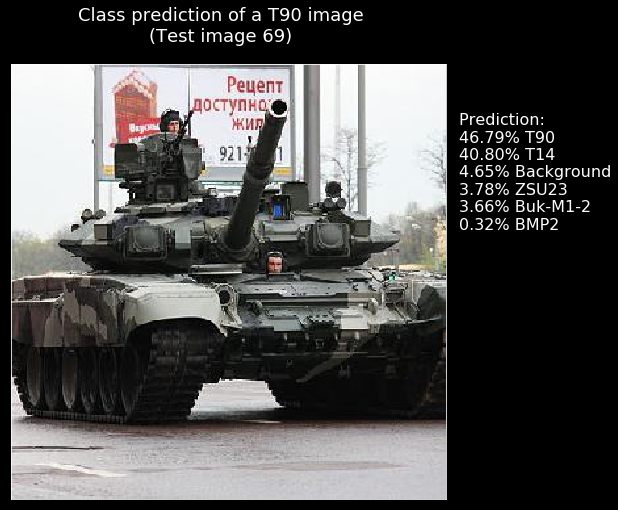

Image 70 : [(60.21, 'T90'), (29.3, 'Buk-M1-2'), (5.54, 'Background'), (3.19, 'T14'), (1.2, 'BMP2'), (0.56, 'ZSU23')]


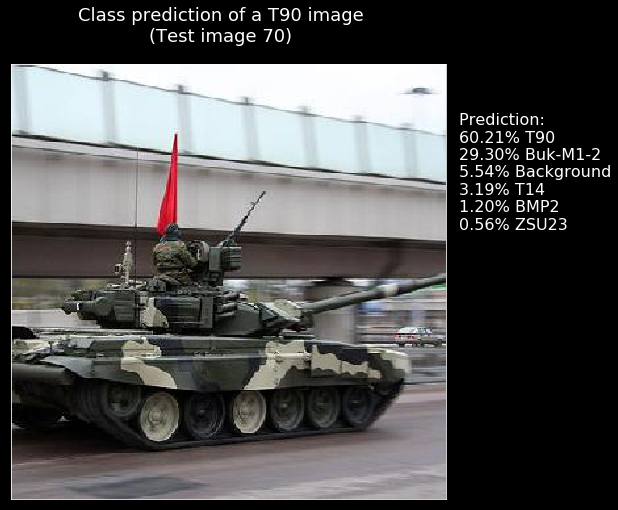

Image 71 : [(87.07, 'T90'), (7.53, 'Buk-M1-2'), (3.09, 'T14'), (1.27, 'Background'), (0.79, 'ZSU23'), (0.25, 'BMP2')]


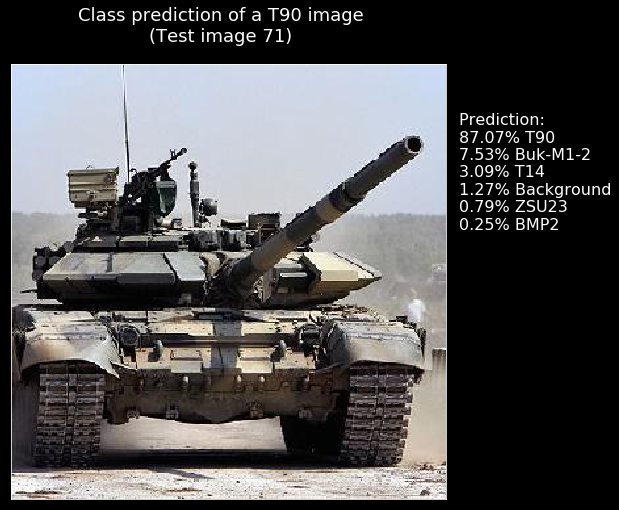

Image 72 : [(44.38, 'Buk-M1-2'), (31.15, 'T90'), (10.53, 'BMP2'), (7.82, 'Background'), (3.47, 'ZSU23'), (2.66, 'T14')]


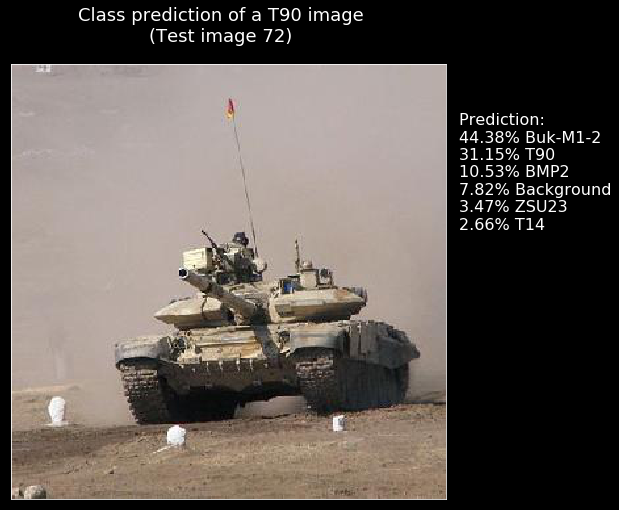

Image 73 : [(45.88, 'T14'), (44.91, 'T90'), (5.3, 'BMP2'), (2.14, 'Background'), (1.28, 'Buk-M1-2'), (0.48, 'ZSU23')]


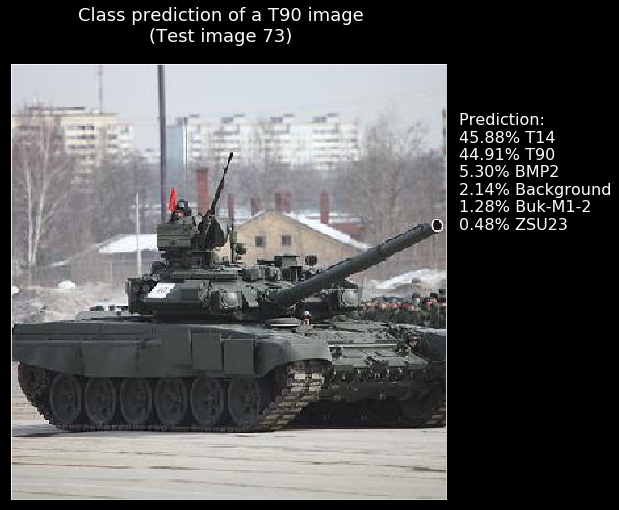

Image 74 : [(84.73, 'T90'), (9.93, 'T14'), (2.86, 'ZSU23'), (1.14, 'Buk-M1-2'), (1.03, 'Background'), (0.31, 'BMP2')]


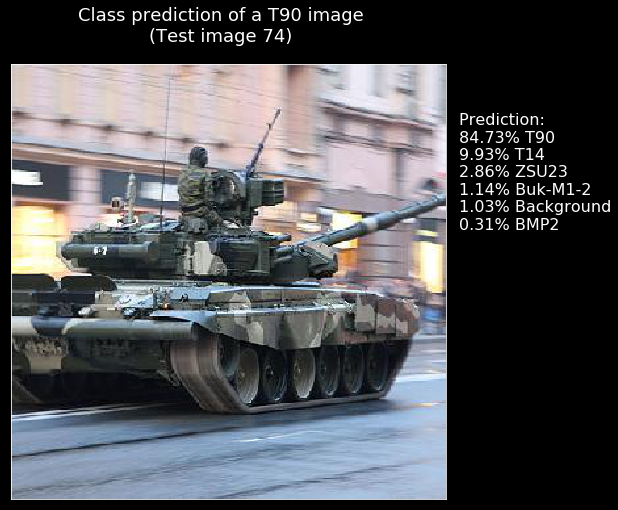

Image 75 : [(57.49, 'T90'), (35.69, 'T14'), (3.38, 'Background'), (1.69, 'Buk-M1-2'), (1.17, 'BMP2'), (0.58, 'ZSU23')]


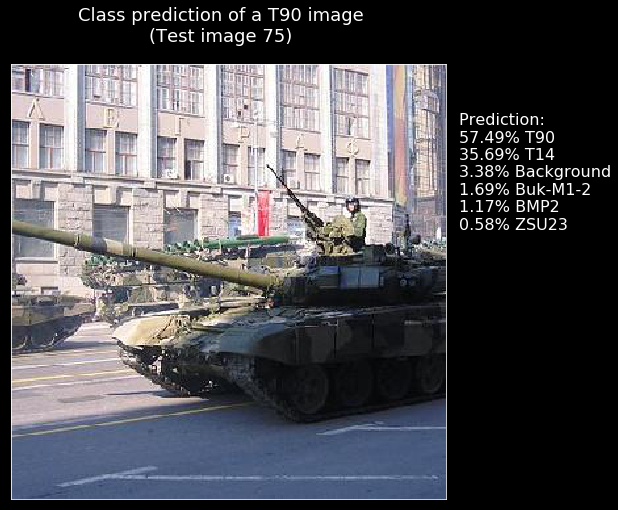

Image 76 : [(89.28, 'ZSU23'), (4.42, 'Buk-M1-2'), (3.21, 'Background'), (2.97, 'T90'), (0.07, 'BMP2'), (0.05, 'T14')]


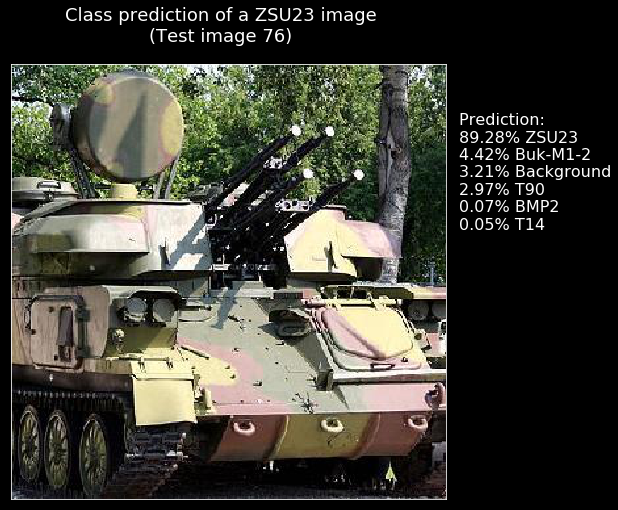

Image 77 : [(37.35, 'Buk-M1-2'), (34.62, 'ZSU23'), (18.22, 'T90'), (9.36, 'Background'), (0.31, 'T14'), (0.14, 'BMP2')]


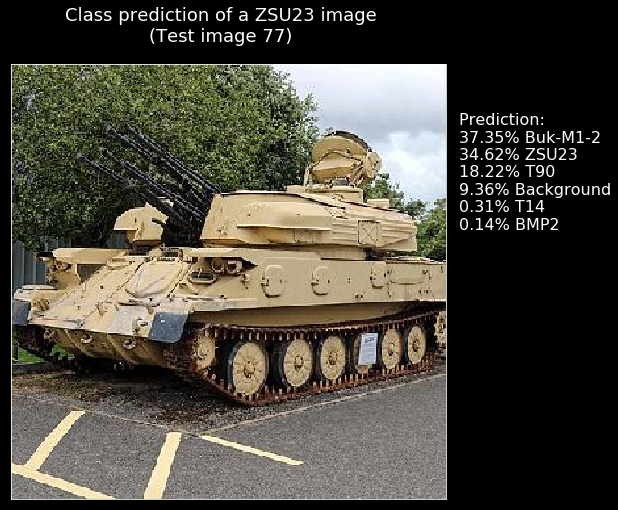

Image 78 : [(86.51, 'Buk-M1-2'), (7.69, 'T90'), (3.63, 'Background'), (1.56, 'ZSU23'), (0.44, 'BMP2'), (0.17, 'T14')]


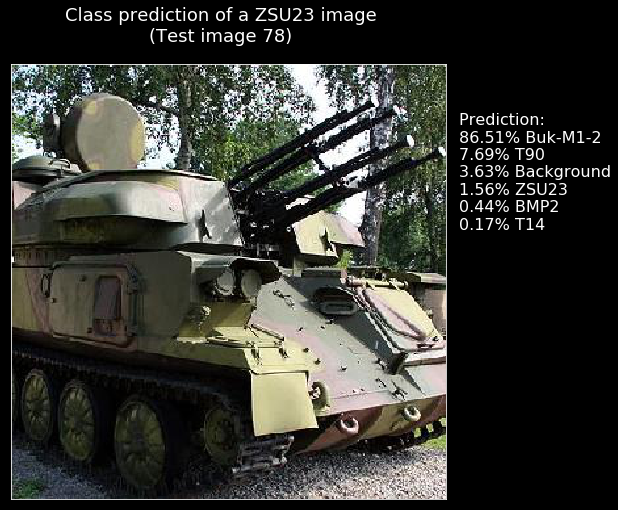

Image 79 : [(99.55, 'ZSU23'), (0.22, 'Background'), (0.19, 'T90'), (0.04, 'Buk-M1-2'), (0.0, 'T14'), (0.0, 'BMP2')]


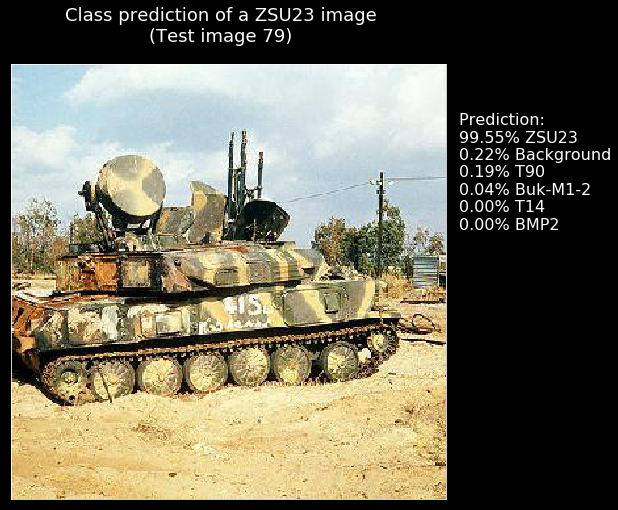

Image 80 : [(84.4, 'ZSU23'), (6.03, 'Buk-M1-2'), (5.07, 'T90'), (3.9, 'Background'), (0.42, 'BMP2'), (0.18, 'T14')]


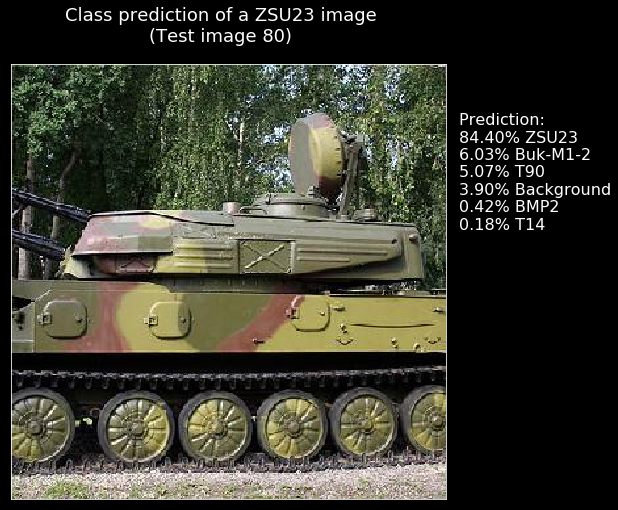

Image 81 : [(63.44, 'ZSU23'), (24.11, 'Buk-M1-2'), (8.67, 'Background'), (3.65, 'T90'), (0.08, 'BMP2'), (0.05, 'T14')]


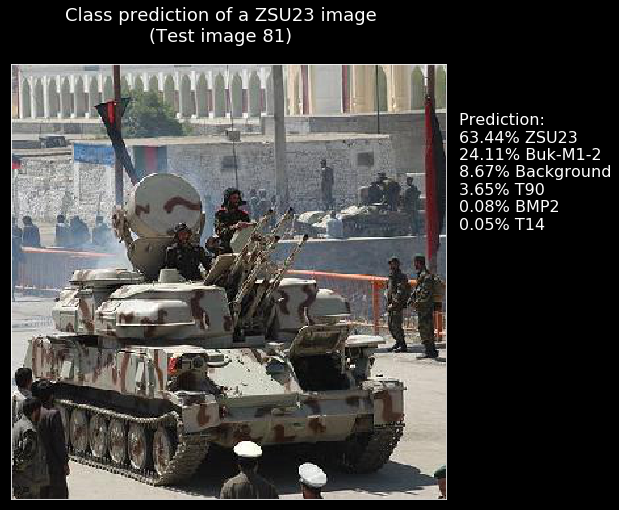

Image 82 : [(56.33, 'ZSU23'), (20.9, 'Background'), (11.17, 'Buk-M1-2'), (7.03, 'T90'), (3.5, 'BMP2'), (1.08, 'T14')]


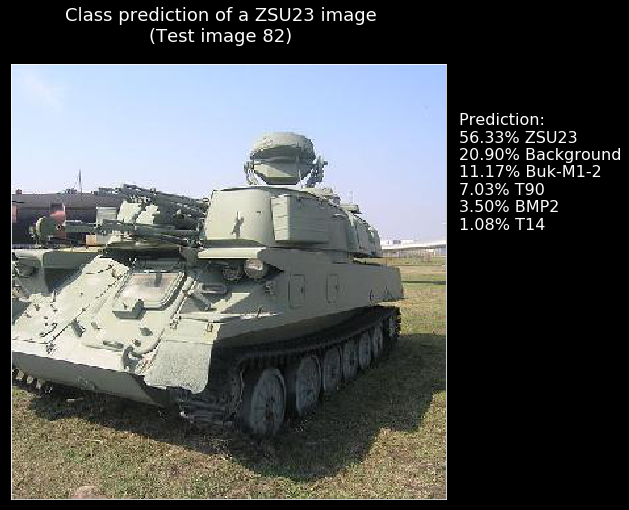

Image 83 : [(91.29, 'Buk-M1-2'), (6.96, 'T90'), (0.83, 'Background'), (0.52, 'T14'), (0.2, 'ZSU23'), (0.19, 'BMP2')]


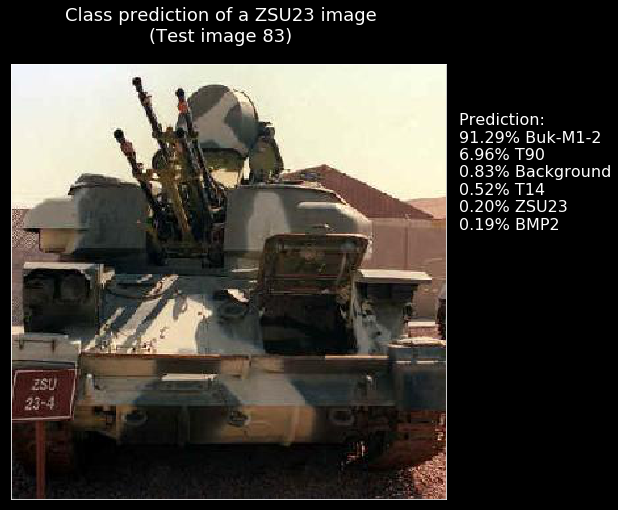

Image 84 : [(67.52, 'ZSU23'), (13.45, 'Buk-M1-2'), (11.31, 'Background'), (5.12, 'T90'), (1.59, 'BMP2'), (1.0, 'T14')]


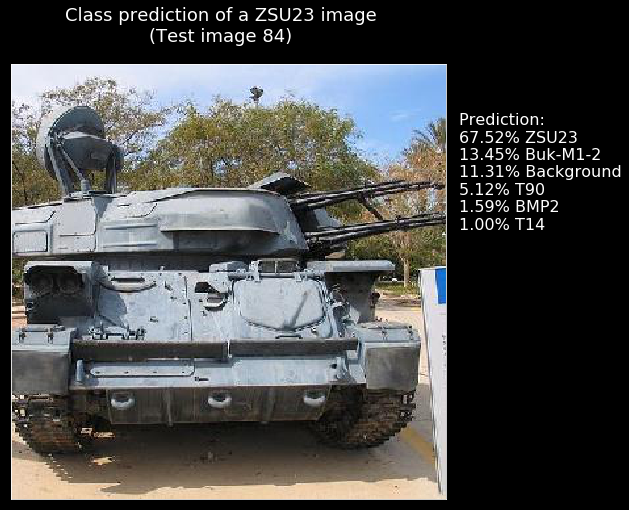

Image 85 : [(96.33, 'Buk-M1-2'), (1.95, 'T90'), (0.62, 'BMP2'), (0.54, 'T14'), (0.47, 'Background'), (0.09, 'ZSU23')]


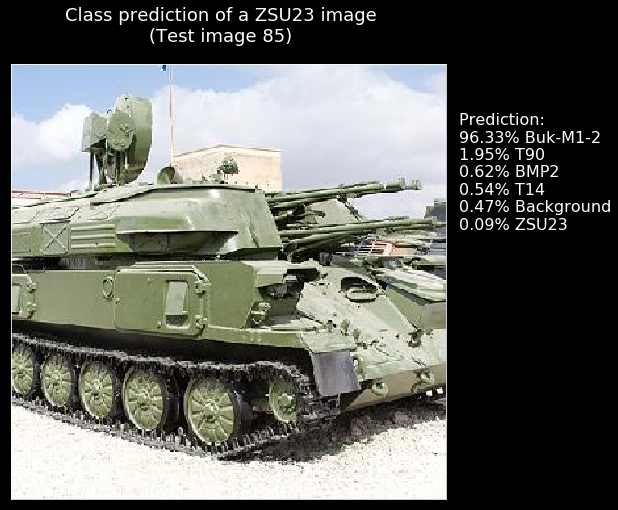

Image 86 : [(99.12, 'ZSU23'), (0.46, 'T90'), (0.35, 'Background'), (0.03, 'Buk-M1-2'), (0.02, 'T14'), (0.02, 'BMP2')]


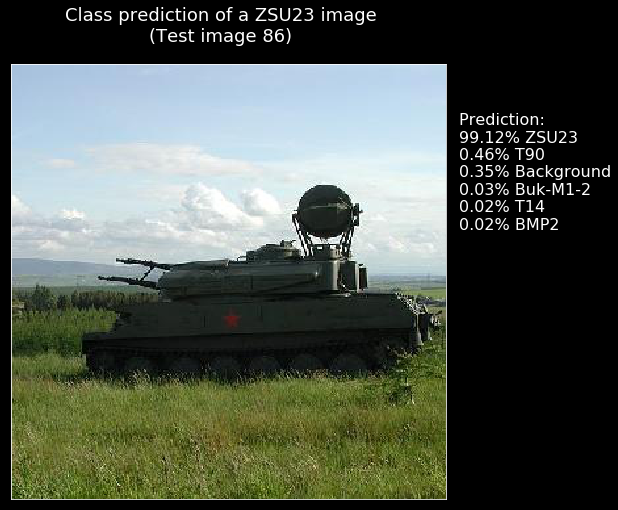

Image 87 : [(82.15, 'ZSU23'), (6.13, 'T90'), (5.84, 'Buk-M1-2'), (5.08, 'Background'), (0.68, 'BMP2'), (0.11, 'T14')]


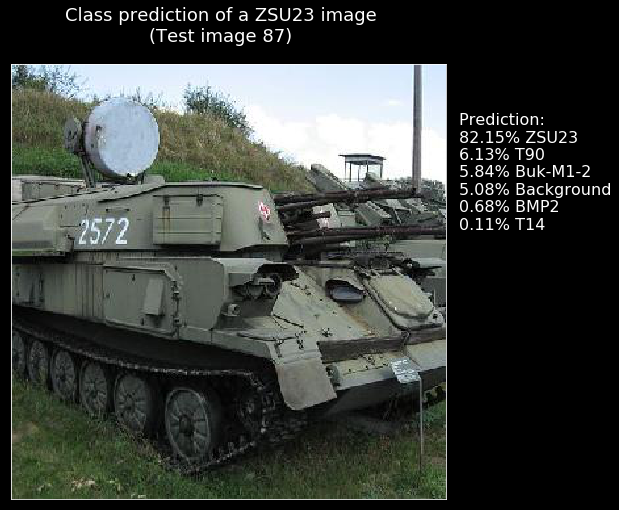

Image 88 : [(99.65, 'ZSU23'), (0.19, 'Background'), (0.12, 'T90'), (0.02, 'Buk-M1-2'), (0.01, 'T14'), (0.01, 'BMP2')]


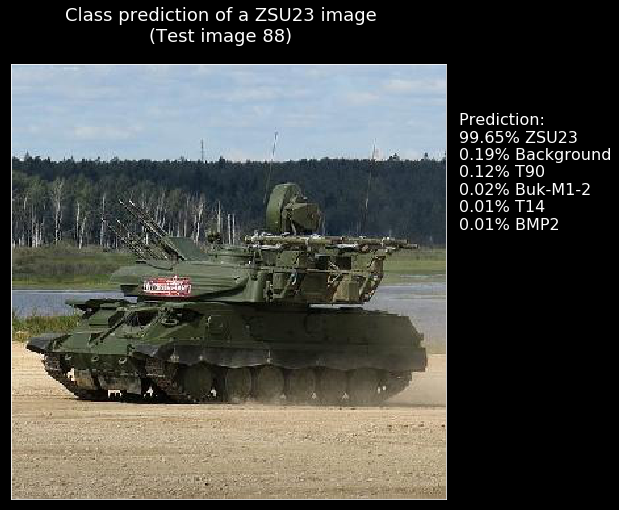

Image 89 : [(97.73, 'ZSU23'), (1.9, 'T90'), (0.27, 'Background'), (0.05, 'Buk-M1-2'), (0.03, 'T14'), (0.01, 'BMP2')]


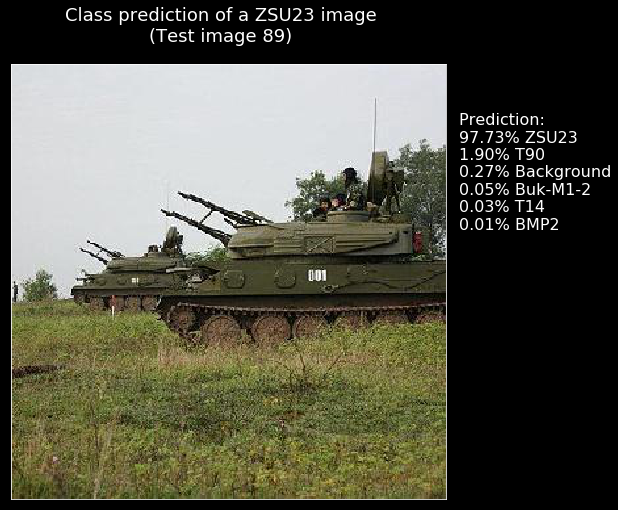

Image 90 : [(85.27, 'BMP2'), (5.41, 'T14'), (4.92, 'Background'), (3.07, 'ZSU23'), (0.75, 'T90'), (0.58, 'Buk-M1-2')]


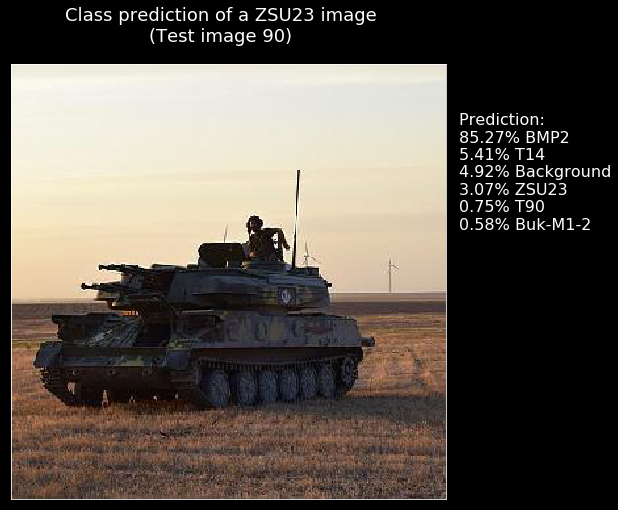

In [8]:
# imports
import os
import matplotlib.pyplot as plt
import numpy as np
from keras import models
from keras.preprocessing import image
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.manifold import TSNE
import seaborn as sns


def main1():
    analysis()
    plot_images()

# Setting Parameters ##################################################################
path = '/content/hw3/'
test_path = path + 'dataset/RuTanks7000_v1/test/'
model_path = path + 'trained_models/RuTanks7000_v1_l2.h5'

# image settings
img_height, img_width = 331, 331

classnames = ["Background", "BMP2", "Buk-M1-2", "T14", "T90", "ZSU23"]

# test data generator
test_datagen = image.ImageDataGenerator(rescale=1. / 255)
test_generator = test_datagen.flow_from_directory(
    test_path,
    target_size=(img_height, img_width),
    batch_size=1,
    shuffle=False,
    classes=classnames,
    class_mode='categorical')

# counting test images
nbrTestImages = 0  # Value gets accurate after counting
for ImagesClass in os.listdir(test_path):
    nbrTestImages += len(os.listdir(test_path + ImagesClass))

# saving test images from test generator
test_images = []
for i in range(nbrTestImages):
    test_images.append(test_generator.next()[0][0])

test_images_path = []
true_labels = []
true_labels_class = []

test_images_Background = os.listdir(test_path + 'Background')
for imagefile in test_images_Background:
    test_images_path.append(test_path + 'Background/' + imagefile)
    true_labels.append(0)
    true_labels_class.append('Background')

test_images_BMP2 = os.listdir(test_path + 'BMP2')
for imagefile in test_images_BMP2:
    test_images_path.append(test_path + 'BMP2/' + imagefile)
    true_labels.append(1)
    true_labels_class.append('BMP2')

test_images_Buk = os.listdir(test_path + 'Buk-M1-2')
for imagefile in test_images_Buk:
    test_images_path.append(test_path + 'Buk-M1-2/' + imagefile)
    true_labels.append(2)
    true_labels_class.append('Buk-M1-2')

test_images_T14 = os.listdir(test_path + 'T14')
for imagefile in test_images_T14:
    test_images_path.append(test_path + 'T14/' + imagefile)
    true_labels.append(3)
    true_labels_class.append('T14')

test_images_T90 = os.listdir(test_path + 'T90')
for imagefile in test_images_T90:
    test_images_path.append(test_path + 'T90/' + imagefile)
    true_labels.append(4)
    true_labels_class.append('T90')

test_images_ZSU23 = os.listdir(test_path + 'ZSU23')
for imagefile in test_images_ZSU23:
    test_images_path.append(test_path + 'ZSU23/' + imagefile)
    true_labels.append(5)
    true_labels_class.append('ZSU23')


# Returns the compiled model identical to the previously saved one
print("Loading the trained model from " + model_path + " ...\n")
model = models.load_model(model_path)
print("\nTrained model " + model_path + ":")
model.summary()

# predicting labels
pred = model.predict_generator(test_generator, nbrTestImages)
print("Dataset at", test_path, "has", pred.shape[0], "images with", pred.shape[1], "class predictions each")


def analysis():
    # testing the model
    print("\n### Testing the loaded model ... ")
    test_loss, test_acc = model.evaluate_generator(test_generator, steps=nbrTestImages, verbose=1)
    print('Test Results of the trained Model:\nTest loss:', test_loss, ",", 'test accuracy:', test_acc)

    # Confusion Matrix and Classification Report
    pred_argmax = np.argmax(pred, axis=1)
    print('\nConfusion Matrix')
    print(confusion_matrix(test_generator.classes, pred_argmax))
    print('\nClassification Report')
    print(classification_report(test_generator.classes, pred_argmax, target_names=classnames))

    # t-SNE Visualization: t-Distributed Stochastic Neighbor Embedding (t-SNE) for visualizing high-dimensional data.
    img_tensors = []
    for i in range(len(test_images)):
        pred_img = image.load_img(test_images_path[i], target_size=(331, 331))
        img_tensor = image.img_to_array(pred_img)
        img_tensor = np.expand_dims(img_tensor, axis=0)
        img_tensor /= 255.
        img_tensors.append(img_tensor)

    # Last conv layer
    layer = model.get_layer('dense_1')
    layer_output = layer.output
    activation_model = models.Model(input=model.input, outputs=[layer_output])

    img_tensors = np.asarray(img_tensors)
    img_tensors_array = np.concatenate((img_tensors))
    print("img_tensors_array.shape=", img_tensors_array.shape)

    activations = activation_model.predict(img_tensors_array)
    print("activations.shape=", activations.shape)

    # calculating tsne #https://www.datacamp.com/community/tutorials/introduction-t-sne
    tsne = TSNE(random_state=42).fit_transform(activations)

    # Visualization of the feature vectors produce by the convnet
    num_classes = len(classnames)
    palette = np.array(sns.color_palette("husl", num_classes))
    label_array = np.asarray(true_labels)

    # create a scatter plot.
    fig = plt.figure(figsize=(12, 12))
    fig.patch.set_facecolor('black')
    plt.style.use('dark_background')
    plt.scatter(tsne[:, 0], tsne[:, 1], lw=0, s=90, c=palette[label_array])
    plt.axis('tight')

    txts = []
    for j in range(num_classes):
        # Position of each label at median of data points.
        xtext, ytext = np.median(tsne[label_array == j, :], axis=0)
        txt = plt.text(xtext, ytext, classnames[j], fontsize=28, color = 'w')
        txts.append(txt)
    plt.show()


def plot_images():
    # plotting test images with class predictions as title
    print("\nClass Predictions of test images from", test_path)
    for k in range(len(test_images)):
        predictions = []
        for l in range(len(classnames)):
            predictions.append((np.round(pred[k][l] * 100, 2), classnames[l]))
        predictions.sort(reverse=True)
        print("Image", k + 1, ":", predictions)

        plt.figure(figsize=(8, 8))  # width, height in inches.
        plt.style.use('dark_background')
        plt.suptitle("Class prediction of a " + true_labels_class[k] + " image" + "\n(Test image " + str(k + 1) + ")", fontsize=18)
        plt.grid(False)
        plt.xticks([])
        plt.yticks([])
        legend_string = "Prediction: " + \
                        "\n%.2f" % predictions[0][0] + "% " + predictions[0][1] + \
                        "\n%.2f" % predictions[1][0] + "% " + predictions[1][1] + \
                        "\n%.2f" % predictions[2][0] + "% " + predictions[2][1] + \
                        "\n%.2f" % predictions[3][0] + "% " + predictions[3][1] + \
                        "\n%.2f" % predictions[4][0] + "% " + predictions[4][1] + \
                        "\n%.2f" % predictions[5][0] + "% " + predictions[5][1]
        plt.text(img_width + 10, 125, legend_string, fontsize=16)
        plt.imshow(test_images[k])
        plt.show()


main1()


# References
# Chollet, F. (2018). Deep learning with Python. Section 5.3 - Using a pretrained convnet.
# Pathak, M (2018). Introduction to t-SNE. Retrieved from https://www.datacamp.com/community/tutorials/introduction-t-sne